# MORBILIDAD MATERNA EXTREMA - ANALISIS GEOESPACIAL

# Importar librerías

In [22]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
import statsmodels.api as sm
from google.colab import files
from google.colab import drive
import folium # mapas: openstreetmaps

#Librerías para cálculo de distancias, Google routes
!pip install googlemaps
import googlemaps
import geopy.distance
from geopy.distance import distance
from geopy.distance import geodesic
from datetime import datetime

  Preparing metadata (setup.py) ... done
  Created wheel for googlemaps: filename=googlemaps-4.10.0-py3-none-any.whl size=40712 sha256=b8469a4b63ce60eaabb228e49409994702508384a7d04a8b73f46072e91b4122
  Stored in directory: /root/.cache/pip/wheels/17/f8/79/999d5d37118fd35d7219ef57933eb9d09886c4c4503a800f84
Successfully built googlemaps


# Cálculo de distancias


Google Routes # Requiere usuario Google cloud y configuración de proyecto (Pago por uso)

Haversine # No requiere usuario ni pago

In [ ]:
# Configuración de API Google Routes (Distance matrix

# Clave de API de Google Maps
# api_key = "Tu clave"

# datos = pd.read_excel("archivo.xlsx")

# Configuración de cliente de Google maps
# gmaps = googlemaps.Client(key=api_key)



# Calcular distancia Haversine usando geopy

# datos['distancia_haversine_km'] = datos.apply(
    #lambda row: geodesic(
        #(row['Latitud_h'], row['Longitud_h']),
        #(row['Latitud_r'], row['Longitud_r'])).kilometers,
    #axis=1)

# Calcular tiempo estimado Haversine (estimando una velocidad promedio de 60 km/h)

# datos['tiempo_haversine_est_hrs'] = datos['distancia_haversine_km'] / 60

# Calcular tiempo estimado Haversine en minutos

# datos['tiempo_haversine_est_min'] = datos['tiempo_haversine_est_hrs'] * 60

# Definir la función para calcular rutas y tiempos utilizando Google Maps

# def calcular_rutas_tiempos(lat_h, lon_h, lat_r, lon_r):
    #try:
        #directions_result = gmaps.directions(
            #origin=(lat_h, lon_h),
            #destination=(lat_r, lon_r),
            #mode="driving")
        #distancia_routes = directions_result[0]['legs'][0]['distance']['text']
        #tiempo_routes = directions_result[0]['legs'][0]['duration']['text']
        #return distancia_routes, tiempo_routes
    #except:
        #return "No es posible calcularlo", "No es posible calcularlo"

# Aplicar los cálculos de Google Maps al DataFrame

# datos[['distancia_routes', 'tiempo_routes']] = datos.apply(
    #lambda row: calcular_rutas_tiempos(row['Latitud_h'], row['Longitud_h'], row['Latitud_r'], row['Longitud_r']),
    #axis=1, result_type='expand')

# Guardar el DataFrame actualizado

# datos.to_excel("routes_dt.xlsx", index=False)

# Mostrar las primeras filas

# datos.head()

# Carga y visualización del dataset

In [2]:
uploaded = files.upload()

Saving routes_dt.xlsx to routes_dt.xlsx


In [4]:
final = pd.read_excel('routes_dt.xlsx')

Head del dataset (Anonimizado)

In [5]:
pd.set_option('display.max_columns', None)
final.head()

,num_ide_,Longitud_h,Latitud_h,Longitud_r,Latitud_r,distancia_routes,tiempo_routes,distancia_haversine_km,tiempo_haversine_est_min,num_gestac,num_parvag,num_cesare,num_aborto,num_molas,num_muerto,num_vivos,no_con_pre,sem_c_pren,preclampsi,emb_mult,ed_ter_ges,ed_ter_ges.1,dias_hospi,no_con_pre_le_4,edad_ge_35,edad_le_19,edad_,multi_organ_disfuncion,num_organos_disfuncion,larga_estancia_90,etnia_afrocolombiano,etnia_Indigena,tip_ss_S,tip_ss_C,Trastornos hipertensivos,Complicaciones hemorrágicas,Complicaciones de aborto,Sepsis de origen obstétrico,Sepsis de origen no obstétrico,Sepsis de origen pulmonar,Enfermedad preexistente que se complica,Otra causa,Inst_corregida,ndep_proce,nmun_proce,año,mes,trimestre,sem_ges_
0,1,-76.288237,4.157459,-76.525715,3.372201,115.472,127.700000,90.751545,90.751545,1,0,0,0,0,0,0,6,7,0,0,0,0,2,0,0,1,18,0,1,0,0,0,1,0,0,0,0,1,0,0,0,0,ESE HOSPITAL KENNEDY DE RIOFRÍO,VALLE,RIOFRÍO,2023,1,Trimestre 1,32
1,2,-76.481252,3.456462,-76.525715,3.372201,12.560,28.150000,10.546434,10.546434,1,1,0,0,0,0,1,2,6,1,0,0,0,3,1,0,0,24,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,Centro De Salud Alfonso Lopez 3,VALLE,CALI,2019,8,Trimestre 3,35
2,3,-76.481252,3.456462,-76.525715,3.372201,12.560,28.150000,10.546434,10.546434,2,0,1,0,0,0,2,6,13,1,0,0,0,1,0,0,0,21,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,Centro De Salud Alfonso Lopez 3,VALLE,CALI,2018,5,Trimestre 2,34
3,4,-76.514718,3.402276,-76.525715,3.372201,5.375,13.300000,3.543066,3.543066,2,2,0,0,0,1,1,5,12,1,0,0,0,1,0,0,1,18,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,Centro de Salud de Mariano Ramos,VALLE,CALI,2018,5,Trimestre 2,32
4,5,-76.464025,3.422200,-76.525715,3.372201,11.771,30.533333,8.806981,8.806981,1,0,1,0,0,0,1,0,0,0,0,0,0,13,1,0,1,18,1,2,1,0,0,0,1,0,0,0,1,0,0,0,0,CENTRO DE SALUD DECEPAZ - ESE ORIENTE,VALLE,CALI,2019,9,Trimestre 3,36


In [6]:
final.shape

(2453, 49)

In [7]:
final.dtypes


num_ide_                                     int64
Longitud_h                                 float64
Latitud_h                                  float64
Longitud_r                                 float64
Latitud_r                                  float64
distancia_routes                           float64
tiempo_routes                              float64
distancia_haversine_km                     float64
tiempo_haversine_est_min                   float64
num_gestac                                   int64
num_parvag                                   int64
num_cesare                                   int64
num_aborto                                   int64
num_molas                                    int64
num_muerto                                   int64
num_vivos                                    int64
no_con_pre                                   int64
sem_c_pren                                   int64
preclampsi                                   int64
emb_mult                       

Histograma distribución de variables de tiempo y distancia

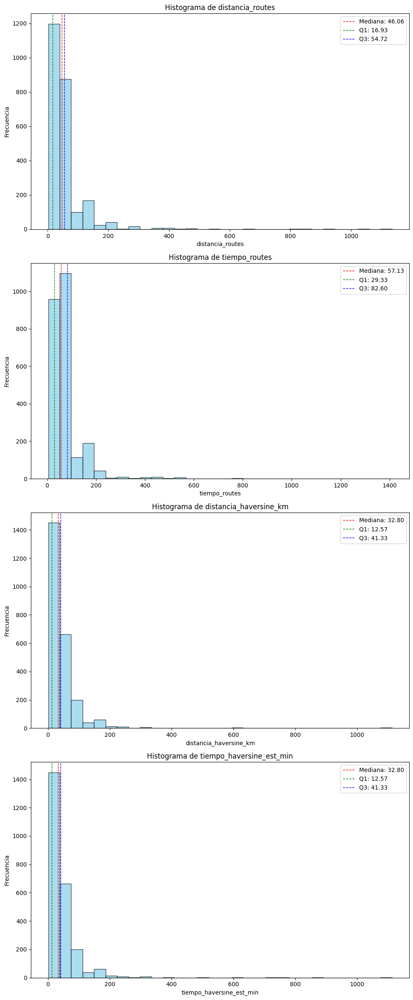

In [8]:
# Definir las columnas para las cuales queremos histogramas
columnas = ['distancia_routes', 'tiempo_routes', 'distancia_haversine_km', 'tiempo_haversine_est_min']

# Configuración de la figura
fig, axes = plt.subplots(len(columnas), 1, figsize=(10, 6 * len(columnas)))  # Ajustar el tamaño según el número de gráficos

# Generar un histograma para cada columna
for ax, columna in zip(axes, columnas):
    data = final[columna]  # Asumiendo que 'final' es tu DataFrame
    median = data.median()
    q1 = data.quantile(0.25)
    q3 = data.quantile(0.75)

    # Crear el histograma
    ax.hist(data, bins=30, color='skyblue', alpha=0.7, edgecolor='black')
    # Añadir línea de mediana
    ax.axvline(median, color='red', linestyle='dashed', linewidth=1, label=f'Mediana: {median:.2f}')
    # Añadir línea de Q1
    ax.axvline(q1, color='green', linestyle='dashed', linewidth=1, label=f'Q1: {q1:.2f}')
    # Añadir línea de Q3
    ax.axvline(q3, color='blue', linestyle='dashed', linewidth=1, label=f'Q3: {q3:.2f}')

    # Título y etiquetas
    ax.set_title(f'Histograma de {columna}')
    ax.set_xlabel(columna)
    ax.set_ylabel('Frecuencia')
    ax.legend()

plt.tight_layout()  # Ajusta automáticamente los subplots para que no se superpongan
plt.show()


# ANÁLISIS UNIVARIADO DE DISTANCIAS Y TIEMPOS

Análisis univariado (Odds ratio (OR) y riesgo relativo (RR - Poisson))

In [23]:
# Normalizar
scaler = StandardScaler()
final_scaled = final.copy()

variables_interes = [
    'distancia_routes', 'tiempo_routes', 'distancia_haversine_km', 'tiempo_haversine_est_min'
]

final_scaled[variables_interes] = scaler.fit_transform(final_scaled[variables_interes])

#  OR e IC
def calculate_odds_ratio_uni(result, variable):
    params = result.params
    conf = result.conf_int()
    or_value = np.exp(params[variable])
    conf_int = conf.loc[variable].apply(np.exp)
    return or_value, conf_int[0], conf_int[1]

def logistic_regression_uni(df, variable, outcome):
    df_uni = df[[variable, outcome]].dropna()
    if df_uni[variable].dtype == 'object':
        df_uni = pd.get_dummies(df_uni, columns=[variable], drop_first=True)
    X_uni = df_uni.drop(outcome, axis=1)
    y_uni = df_uni[outcome]
    X_uni = sm.add_constant(X_uni)
    model_uni = sm.Logit(y_uni, X_uni)
    result_uni = model_uni.fit(disp=0)
    or_value, ci_lower, ci_upper = calculate_odds_ratio_uni(result_uni, X_uni.columns[1])
    return or_value, ci_lower, ci_upper

# RR y IC
def calculate_risk_ratio_uni(result, variable):
    params = result.params
    conf = result.conf_int()
    rr_value = np.exp(params[variable])
    conf_int = conf.loc[variable].apply(np.exp)
    return rr_value, conf_int[0], conf_int[1]

def poisson_regression_uni(df, variable, outcome):
    df_uni = df[[variable, outcome]].dropna()
    if df_uni[variable].dtype == 'object':
        df_uni = pd.get_dummies(df_uni, columns=[variable], drop_first=True)
    X_uni = df_uni.drop(outcome, axis=1)
    y_uni = df_uni[outcome]
    X_uni = sm.add_constant(X_uni)
    model_uni = sm.GLM(y_uni, X_uni, family=sm.families.Poisson())
    result_uni = model_uni.fit(disp=0)
    rr_value, ci_lower, ci_upper = calculate_risk_ratio_uni(result_uni, X_uni.columns[1])
    return rr_value, ci_lower, ci_upper

# resultados
or_results_multi = {}
rr_results_multi = {}
or_results_larga = {}
rr_results_larga = {}

# OR y RR univariados para 'multi_organ_disfuncion'
for var in variables_interes:
    or_results_multi[var] = logistic_regression_uni(final_scaled, var, 'multi_organ_disfuncion')
    rr_results_multi[var] = poisson_regression_uni(final_scaled, var, 'multi_organ_disfuncion')

# OR y RR univariados para 'larga_estancia_90'
for var in variables_interes:
    or_results_larga[var] = logistic_regression_uni(final_scaled, var, 'larga_estancia_90')
    rr_results_larga[var] = poisson_regression_uni(final_scaled, var, 'larga_estancia_90')

# Resultados
df_or_results_multi = pd.DataFrame(or_results_multi, index=['OR', 'CI Lower', 'CI Upper']).T
df_rr_results_multi = pd.DataFrame(rr_results_multi, index=['RR', 'CI Lower', 'CI Upper']).T
df_or_results_larga = pd.DataFrame(or_results_larga, index=['OR', 'CI Lower', 'CI Upper']).T
df_rr_results_larga = pd.DataFrame(rr_results_larga, index=['RR', 'CI Lower', 'CI Upper']).T

print("Resultados OR multi_organ_disfuncion:")
print(df_or_results_multi)

print("\nResultados RR multi_organ_disfuncion:")
print(df_rr_results_multi)

print("\nResultados OR larga_estancia_90:")
print(df_or_results_larga)

print("\nResultados RR larga_estancia_90:")
print(df_rr_results_larga)


Resultados OR multi_organ_disfuncion:
                                OR  CI Lower  CI Upper
distancia_routes          1.263301  1.152057  1.385287
tiempo_routes             1.262026  1.151538  1.383115
distancia_haversine_km    1.216574  1.107810  1.336016
tiempo_haversine_est_min  1.216574  1.107810  1.336016

Resultados RR multi_organ_disfuncion:
                                RR  CI Lower  CI Upper
distancia_routes          1.158537  1.095275  1.225453
tiempo_routes             1.157673  1.094659  1.224314
distancia_haversine_km    1.125792  1.067146  1.187660
tiempo_haversine_est_min  1.125792  1.067146  1.187660

Resultados OR larga_estancia_90:
                                OR  CI Lower  CI Upper
distancia_routes          1.232042  1.123050  1.351613
tiempo_routes             1.237449  1.127906  1.357631
distancia_haversine_km    1.303560  1.174321  1.447022
tiempo_haversine_est_min  1.303560  1.174321  1.447022

Resultados RR larga_estancia_90:
                              

Cálculo de percentiles 70 - 90 de la distribución de tiempo y distancia

In [24]:
# Variables de interés
variables_interes = [
    'distancia_routes', 'tiempo_routes', 'distancia_haversine_km', 'tiempo_haversine_est_min'
]

# Normalizar las variables de interés
scaler = StandardScaler()
final_scaled = final.copy()
final_scaled[variables_interes] = scaler.fit_transform(final_scaled[variables_interes])

# Calcular los percentiles 75 y 90 para las variables de distancia y tiempo
percentiles = [0.75, 0.90]
percentile_values = final[variables_interes].quantile(percentiles)

# Mostrar los valores de los percentiles 75 y 90
print("Valores de los percentiles 75 y 90 para las variables de distancia y tiempo:")
print(percentile_values)

# Convertir los resultados a un DataFrame para una mejor visualización
percentile_values_df = percentile_values.T
percentile_values_df.columns = ['Percentil 75', 'Percentil 90']

# Mostrar la tabla de resultados
print("\nTabla de Percentiles:")
print(percentile_values_df)


Valores de los percentiles 75 y 90 para las variables de distancia y tiempo:
      distancia_routes  tiempo_routes  distancia_haversine_km  \
0.75            54.717      82.600000               41.334461   
0.90           125.109     152.733333               86.945418   

      tiempo_haversine_est_min  
0.75                 41.334461  
0.90                 86.945418  

Tabla de Percentiles:
                          Percentil 75  Percentil 90
distancia_routes             54.717000    125.109000
tiempo_routes                82.600000    152.733333
distancia_haversine_km       41.334461     86.945418
tiempo_haversine_est_min     41.334461     86.945418


# ANALISIS DE RIESGO (OR Y RR) PARA DISTANCIA Y TIEMPO DE TRASLADO

Cálculo de riesgo para percentiles específicos de tiempo y distancia

In [25]:
# Variables de interés
variables_interes = [
    'distancia_routes', 'tiempo_routes', 'distancia_haversine_km', 'tiempo_haversine_est_min'
]
y_vars = ['multi_organ_disfuncion', 'larga_estancia_90']

# Normalizar las variables de interés
scaler = StandardScaler()
final_scaled = final.copy()
final_scaled[variables_interes] = scaler.fit_transform(final_scaled[variables_interes])

# Función para calcular OR y su intervalo de confianza
def calculate_odds_ratio_uni(result, variable):
    params = result.params
    conf = result.conf_int()
    or_value = np.exp(params[variable])
    conf_int = conf.loc[variable].apply(np.exp)
    return or_value, conf_int[0], conf_int[1]

# Función para ajustar un modelo logístico univariado y calcular el OR
def logistic_regression_uni(df, variable, outcome):
    df_uni = df[[variable, outcome]].dropna()
    X_uni = df_uni.drop(outcome, axis=1)
    y_uni = df_uni[outcome]
    X_uni = sm.add_constant(X_uni)
    model_uni = sm.Logit(y_uni, X_uni)
    result_uni = model_uni.fit(disp=0)
    or_value, ci_lower, ci_upper = calculate_odds_ratio_uni(result_uni, variable)
    return or_value, ci_lower, ci_upper

# Función para calcular RR y su intervalo de confianza usando Poisson
def calculate_risk_ratio_uni(result, variable):
    params = result.params
    conf = result.conf_int()
    rr_value = np.exp(params[variable])
    conf_int = conf.loc[variable].apply(np.exp)
    return rr_value, conf_int[0], conf_int[1]

# Función para ajustar un modelo de Poisson univariado y calcular el RR
def poisson_regression_uni(df, variable, outcome):
    df_uni = df[[variable, outcome]].dropna()
    X_uni = df_uni.drop(outcome, axis=1)
    y_uni = df_uni[outcome]
    X_uni = sm.add_constant(X_uni)
    model_uni = sm.GLM(y_uni, X_uni, family=sm.families.Poisson())
    result_uni = model_uni.fit(disp=0)
    rr_value, ci_lower, ci_upper = calculate_risk_ratio_uni(result_uni, variable)
    return rr_value, ci_lower, ci_upper

# Definir percentiles de interés
percentiles = [5,10,15,20,25,30,35,40,45,50,55,60,65,70,75,80,85,90,95,99]

# Diccionarios para guardar los resultados
or_results_percentiles = {}
rr_results_percentiles = {}

# Función para calcular OR y RR por percentiles
def calculate_risks_by_percentiles(df, variable, outcome):
    results = {'OR': {}, 'RR': {}}
    for p in percentiles:
        threshold = np.percentile(df[variable], p)
        df['above_threshold'] = (df[variable] > threshold).astype(int)

        or_value, ci_lower_or, ci_upper_or = logistic_regression_uni(df, 'above_threshold', outcome)
        rr_value, ci_lower_rr, ci_upper_rr = poisson_regression_uni(df, 'above_threshold', outcome)

        results['OR'][p] = (or_value, ci_lower_or, ci_upper_or)
        results['RR'][p] = (rr_value, ci_lower_rr, ci_upper_rr)

    return results

# Calcular OR y RR por percentiles para cada variable de interés y cada outcome
for var in variables_interes:
    or_results_percentiles[var] = {}
    rr_results_percentiles[var] = {}
    for outcome in y_vars:
        results = calculate_risks_by_percentiles(final_scaled, var, outcome)
        or_results_percentiles[var][outcome] = results['OR']
        rr_results_percentiles[var][outcome] = results['RR']

# Mostrar resultados
for var in variables_interes:
    for outcome in y_vars:
        print(f"\nResultados OR por percentiles para {var} y {outcome}:")
        print(pd.DataFrame(or_results_percentiles[var][outcome], index=['OR', 'CI Lower', 'CI Upper']).T)

        print(f"\nResultados RR por percentiles para {var} y {outcome}:")
        print(pd.DataFrame(rr_results_percentiles[var][outcome], index=['RR', 'CI Lower', 'CI Upper']).T)



Resultados OR por percentiles para distancia_routes y multi_organ_disfuncion:
          OR  CI Lower  CI Upper
5   0.701910  0.452792  1.088090
10  0.842835  0.626266  1.134294
15  0.878182  0.656632  1.174484
20  0.709978  0.554547  0.908975
25  0.890509  0.705136  1.124614
30  0.897892  0.712420  1.131649
35  1.038911  0.828767  1.302339
40  1.130916  0.906832  1.410373
45  1.131925  0.909486  1.408767
50  1.219619  0.981264  1.515872
55  1.181623  0.948170  1.472555
60  1.181623  0.948170  1.472555
65  1.239677  0.991115  1.550576
70  1.585398  1.257980  1.998034
75  1.666111  1.316823  2.108049
80  2.130137  1.666388  2.722947
85  2.273990  1.747054  2.959856
90  2.380568  1.757503  3.224520
95  2.529076  1.696988  3.769164
99  3.615520  1.612196  8.108185

Resultados RR por percentiles para distancia_routes y multi_organ_disfuncion:
          RR  CI Lower  CI Upper
5   0.748234  0.506067  1.106285
10  0.867158  0.662099  1.135726
15  0.897113  0.688389  1.169124
20  0.752753  0.6

Obtención de distancias y tiempos correspondientes a percentiles

In [26]:
# Variables de interés
variables_interes = ['distancia_routes', 'tiempo_routes']

# Normalizar las variables de interés
scaler = StandardScaler()
final_scaled = final.copy()
final_scaled[variables_interes] = scaler.fit_transform(final_scaled[variables_interes])

# Calcular los percentiles específicos
percentiles_especificos = [5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80, 85, 90, 95, 99]
percentile_values_scaled = final_scaled[variables_interes].quantile([p / 100 for p in percentiles_especificos])

# Desescalar los percentiles para obtener valores reales
percentile_values_real = scaler.inverse_transform(percentile_values_scaled)

# Convertir los resultados a un DataFrame para una mejor visualización
percentile_values_df = pd.DataFrame(percentile_values_real, index=percentiles_especificos, columns=variables_interes)
percentile_values_df.index.name = 'Percentil'

print("\nTabla de Percentiles:")
print(percentile_values_df)



Tabla de Percentiles:
           distancia_routes  tiempo_routes
Percentil                                 
5                   5.10000      12.650000
10                  8.64800      22.950000
15                  9.97200      24.300000
20                 11.23400      25.900000
25                 16.92500      29.333333
30                 17.19900      30.633333
35                 23.93300      33.716667
40                 36.51800      51.816667
45                 38.50100      57.133333
50                 46.06200      57.133333
55                 47.46300      57.133333
60                 47.46300      59.050000
65                 48.41300      65.650000
70                 50.47200      71.200000
75                 54.71700      82.600000
80                 61.89500      96.600000
85                 78.12000     110.000000
90                125.10900     152.733333
95                134.94040     178.370000
99                375.51268     463.842000


# GRÁFICAS DE RIESGO PARA DISTANCIAS Y TIEMPOS DE TRASLADO

OR Y RR para distancias y tiempos


Resultados OR por percentiles para distancia_routes y multi_organ_disfuncion:
          OR  CI Lower  CI Upper
25  0.890509  0.705136  1.124614
50  1.219619  0.981264  1.515872
75  1.666111  1.316823  2.108049
99  3.615520  1.612196  8.108185

Resultados RR por percentiles para distancia_routes y multi_organ_disfuncion:
          RR  CI Lower  CI Upper
25  0.907314  0.732974  1.123122
50  1.181965  0.968097  1.443081
75  1.523770  1.233136  1.882904
99  2.569312  1.371217  4.814239

Resultados OR por percentiles para distancia_routes y larga_estancia_90:
          OR  CI Lower  CI Upper
25  0.795800  0.616976  1.026453
50  0.998941  0.785634  1.270163
75  1.707782  1.319648  2.210072
99  3.389507  1.450065  7.922926

Resultados RR por percentiles para distancia_routes y larga_estancia_90:
          RR  CI Lower  CI Upper
25  0.819544  0.646647  1.038670
50  0.999072  0.797913  1.250946
75  1.586076  1.250772  2.011269
99  2.624865  1.300535  5.297755

Resultados OR por percentiles par

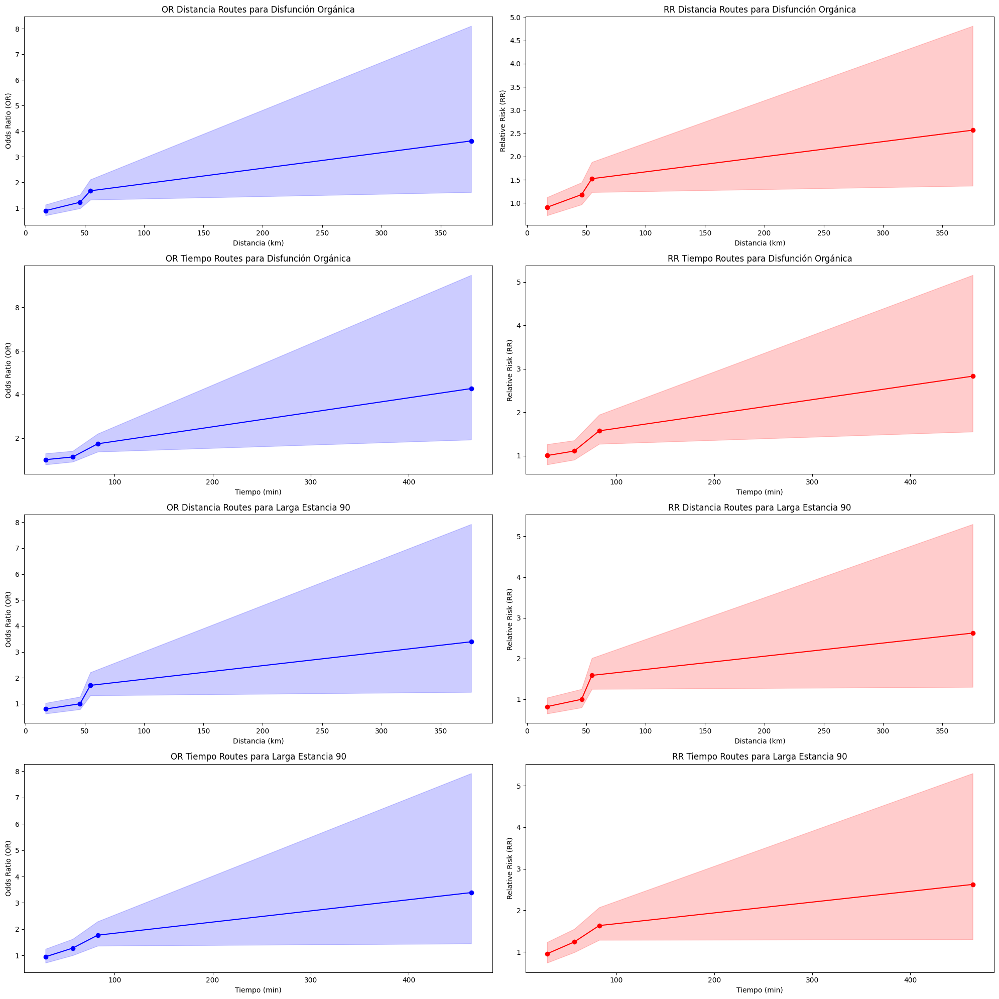

In [27]:
# Variables de interés
variables_interes = [
    'distancia_routes', 'tiempo_routes'
]
y_vars = ['multi_organ_disfuncion', 'larga_estancia_90']

# Normalizar las variables de interés
scaler = StandardScaler()
final_scaled = final.copy()
final_scaled[variables_interes] = scaler.fit_transform(final_scaled[variables_interes])

# Función para calcular OR y su intervalo de confianza
def calculate_odds_ratio_uni(result, variable):
    params = result.params
    conf = result.conf_int()
    or_value = np.exp(params[variable])
    conf_int = conf.loc[variable].apply(np.exp)
    return or_value, conf_int[0], conf_int[1]

# Función para ajustar un modelo logístico univariado y calcular el OR
def logistic_regression_uni(df, variable, outcome):
    df_uni = df[[variable, outcome]].dropna()
    X_uni = df_uni.drop(outcome, axis=1)
    y_uni = df_uni[outcome]
    X_uni = sm.add_constant(X_uni)
    model_uni = sm.Logit(y_uni, X_uni)
    result_uni = model_uni.fit(disp=0)
    or_value, ci_lower, ci_upper = calculate_odds_ratio_uni(result_uni, variable)
    return or_value, ci_lower, ci_upper

# Función para calcular RR y su intervalo de confianza usando Poisson
def calculate_risk_ratio_uni(result, variable):
    params = result.params
    conf = result.conf_int()
    rr_value = np.exp(params[variable])
    conf_int = conf.loc[variable].apply(np.exp)
    return rr_value, conf_int[0], conf_int[1]

# Función para ajustar un modelo de Poisson univariado y calcular el RR
def poisson_regression_uni(df, variable, outcome):
    df_uni = df[[variable, outcome]].dropna()
    X_uni = df_uni.drop(outcome, axis=1)
    y_uni = df_uni[outcome]
    X_uni = sm.add_constant(X_uni)
    model_uni = sm.GLM(y_uni, X_uni, family=sm.families.Poisson())
    result_uni = model_uni.fit(disp=0)
    rr_value, ci_lower, ci_upper = calculate_risk_ratio_uni(result_uni, variable)
    return rr_value, ci_lower, ci_upper

# Definir percentiles de interés del 1 al 100, incluyendo los especificados
percentiles = [25,50,75,99]

# Diccionarios para guardar los resultados
or_results_percentiles = {}
rr_results_percentiles = {}

# Función para calcular OR y RR por percentiles
def calculate_risks_by_percentiles(df, variable, outcome):
    results = {'OR': {}, 'RR': {}}
    for p in percentiles:
        threshold = np.percentile(df[variable], p)
        df['above_threshold'] = (df[variable] > threshold).astype(int)

        or_value, ci_lower_or, ci_upper_or = logistic_regression_uni(df, 'above_threshold', outcome)
        rr_value, ci_lower_rr, ci_upper_rr = poisson_regression_uni(df, 'above_threshold', outcome)

        results['OR'][p] = (or_value, ci_lower_or, ci_upper_or)
        results['RR'][p] = (rr_value, ci_lower_rr, ci_upper_rr)

    return results

# Calcular OR y RR por percentiles para cada variable de interés y cada outcome
for var in variables_interes:
    or_results_percentiles[var] = {}
    rr_results_percentiles[var] = {}
    for outcome in y_vars:
        results = calculate_risks_by_percentiles(final_scaled, var, outcome)
        or_results_percentiles[var][outcome] = results['OR']
        rr_results_percentiles[var][outcome] = results['RR']

# Desescalar los percentiles para obtener valores reales
percentile_values_scaled = final_scaled[variables_interes].quantile([p/100 for p in percentiles])
percentile_values_real = scaler.inverse_transform(percentile_values_scaled)
percentile_values_df = pd.DataFrame(percentile_values_real, index=percentiles, columns=variables_interes)
percentile_values_df.index.name = 'Percentil'

# Mostrar resultados
for var in variables_interes:
    for outcome in y_vars:
        print(f"\nResultados OR por percentiles para {var} y {outcome}:")
        or_results_df = pd.DataFrame(or_results_percentiles[var][outcome], index=['OR', 'CI Lower', 'CI Upper']).T
        print(or_results_df)

        print(f"\nResultados RR por percentiles para {var} y {outcome}:")
        rr_results_df = pd.DataFrame(rr_results_percentiles[var][outcome], index=['RR', 'CI Lower', 'CI Upper']).T
        print(rr_results_df)

# Graficar resultados
fig, axs = plt.subplots(4, 2, figsize=(20, 20))

# Función para graficar
def plot_results(ax, x, y, y_lower, y_upper, title, xlabel, ylabel, color):
    ax.plot(x, y, marker='o', color=color)
    ax.fill_between(x, y_lower, y_upper, color=color, alpha=0.2)
    ax.set_title(title)
    ax.set_xlabel(xlabel)
    ax.set_ylabel(ylabel)

# Subplots para multi_organ_disfuncion
distancia_real = percentile_values_df['distancia_routes'].values
tiempo_real = percentile_values_df['tiempo_routes'].values

plot_results(axs[0, 0], distancia_real, [or_results_percentiles['distancia_routes']['multi_organ_disfuncion'][p][0] for p in percentiles],
             [or_results_percentiles['distancia_routes']['multi_organ_disfuncion'][p][1] for p in percentiles],
             [or_results_percentiles['distancia_routes']['multi_organ_disfuncion'][p][2] for p in percentiles],
             'OR Distancia Routes para Disfunción Orgánica', 'Distancia (km)', 'Odds Ratio (OR)', 'blue')

plot_results(axs[0, 1], distancia_real, [rr_results_percentiles['distancia_routes']['multi_organ_disfuncion'][p][0] for p in percentiles],
             [rr_results_percentiles['distancia_routes']['multi_organ_disfuncion'][p][1] for p in percentiles],
             [rr_results_percentiles['distancia_routes']['multi_organ_disfuncion'][p][2] for p in percentiles],
             'RR Distancia Routes para Disfunción Orgánica', 'Distancia (km)', 'Relative Risk (RR)', 'red')

plot_results(axs[1, 0], tiempo_real, [or_results_percentiles['tiempo_routes']['multi_organ_disfuncion'][p][0] for p in percentiles],
             [or_results_percentiles['tiempo_routes']['multi_organ_disfuncion'][p][1] for p in percentiles],
             [or_results_percentiles['tiempo_routes']['multi_organ_disfuncion'][p][2] for p in percentiles],
             'OR Tiempo Routes para Disfunción Orgánica', 'Tiempo (min)', 'Odds Ratio (OR)', 'blue')

plot_results(axs[1, 1], tiempo_real, [rr_results_percentiles['tiempo_routes']['multi_organ_disfuncion'][p][0] for p in percentiles],
             [rr_results_percentiles['tiempo_routes']['multi_organ_disfuncion'][p][1] for p in percentiles],
             [rr_results_percentiles['tiempo_routes']['multi_organ_disfuncion'][p][2] for p in percentiles],
             'RR Tiempo Routes para Disfunción Orgánica', 'Tiempo (min)', 'Relative Risk (RR)', 'red')

# Subplots para larga_estancia_90
plot_results(axs[2, 0], distancia_real, [or_results_percentiles['distancia_routes']['larga_estancia_90'][p][0] for p in percentiles],
             [or_results_percentiles['distancia_routes']['larga_estancia_90'][p][1] for p in percentiles],
             [or_results_percentiles['distancia_routes']['larga_estancia_90'][p][2] for p in percentiles],
             'OR Distancia Routes para Larga Estancia 90', 'Distancia (km)', 'Odds Ratio (OR)', 'blue')

plot_results(axs[2, 1], distancia_real, [rr_results_percentiles['distancia_routes']['larga_estancia_90'][p][0] for p in percentiles],
             [rr_results_percentiles['distancia_routes']['larga_estancia_90'][p][1] for p in percentiles],
             [rr_results_percentiles['distancia_routes']['larga_estancia_90'][p][2] for p in percentiles],
             'RR Distancia Routes para Larga Estancia 90', 'Distancia (km)', 'Relative Risk (RR)', 'red')

plot_results(axs[3, 0], tiempo_real, [or_results_percentiles['tiempo_routes']['larga_estancia_90'][p][0] for p in percentiles],
             [or_results_percentiles['tiempo_routes']['larga_estancia_90'][p][1] for p in percentiles],
             [or_results_percentiles['tiempo_routes']['larga_estancia_90'][p][2] for p in percentiles],
             'OR Tiempo Routes para Larga Estancia 90', 'Tiempo (min)', 'Odds Ratio (OR)', 'blue')

plot_results(axs[3, 1], tiempo_real, [rr_results_percentiles['tiempo_routes']['larga_estancia_90'][p][0] for p in percentiles],
             [rr_results_percentiles['tiempo_routes']['larga_estancia_90'][p][1] for p in percentiles],
             [rr_results_percentiles['tiempo_routes']['larga_estancia_90'][p][2] for p in percentiles],
             'RR Tiempo Routes para Larga Estancia 90', 'Tiempo (min)', 'Relative Risk (RR)', 'red')

plt.tight_layout()
plt.show()

Percentiles específicos: 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80, 85, 90, 95, 99


Resultados OR por percentiles para distancia_routes y multi_organ_disfuncion:
          OR  CI Lower  CI Upper
5   0.701910  0.452792  1.088090
10  0.842835  0.626266  1.134294
15  0.878182  0.656632  1.174484
20  0.709978  0.554547  0.908975
25  0.890509  0.705136  1.124614
30  0.897892  0.712420  1.131649
35  1.038911  0.828767  1.302339
40  1.130916  0.906832  1.410373
45  1.131925  0.909486  1.408767
50  1.219619  0.981264  1.515872
55  1.181623  0.948170  1.472555
60  1.181623  0.948170  1.472555
65  1.239677  0.991115  1.550576
70  1.585398  1.257980  1.998034
75  1.666111  1.316823  2.108049
80  2.130137  1.666388  2.722947
85  2.273990  1.747054  2.959856
90  2.380568  1.757503  3.224520
95  2.529076  1.696988  3.769164
99  3.615520  1.612196  8.108185

Resultados RR por percentiles para distancia_routes y multi_organ_disfuncion:
          RR  CI Lower  CI Upper
5   0.748234  0.506067  1.106285
10  0.867158  0.662099  1.135726
15  0.897113  0.688389  1.169124
20  0.752753  0.6

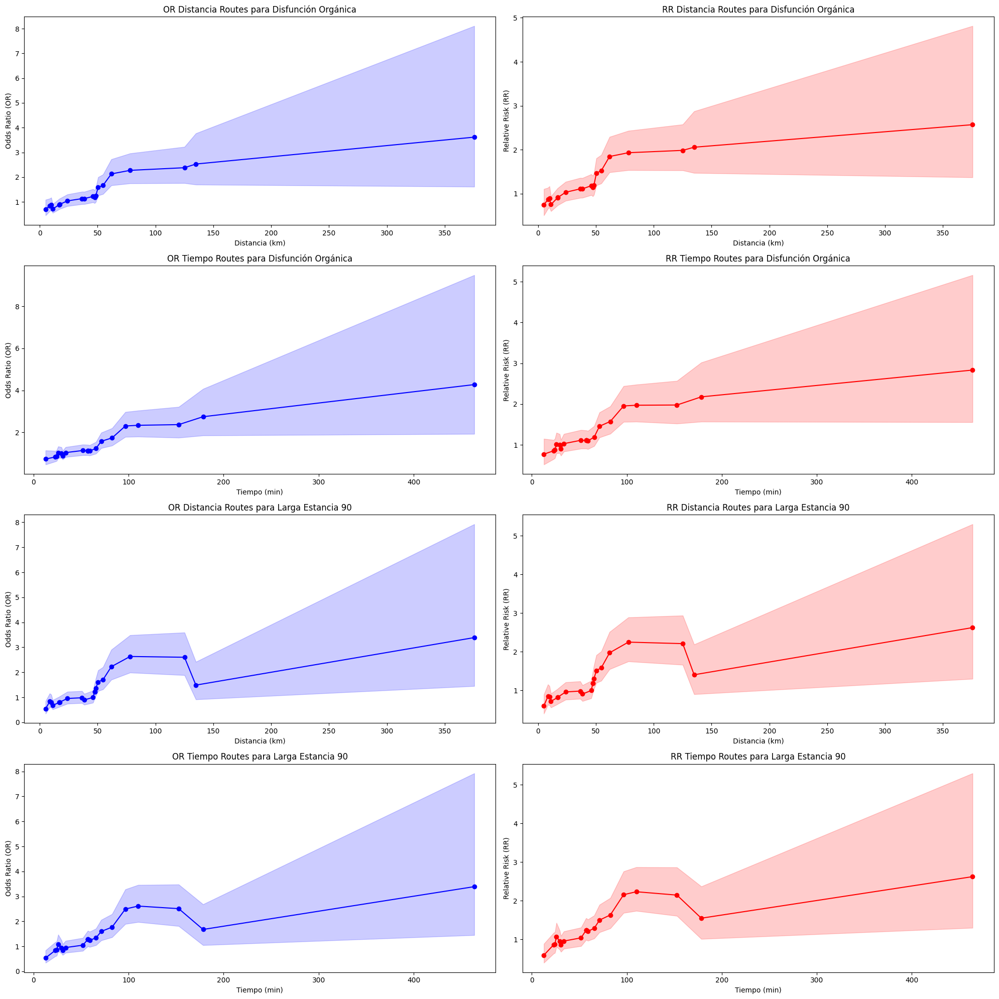

In [28]:
# Variables de interés
variables_interes = [
    'distancia_routes', 'tiempo_routes'
]
y_vars = ['multi_organ_disfuncion', 'larga_estancia_90']

# Normalizar las variables de interés
scaler = StandardScaler()
final_scaled = final.copy()
final_scaled[variables_interes] = scaler.fit_transform(final_scaled[variables_interes])

# Función para calcular OR y su intervalo de confianza
def calculate_odds_ratio_uni(result, variable):
    params = result.params
    conf = result.conf_int()
    or_value = np.exp(params[variable])
    conf_int = conf.loc[variable].apply(np.exp)
    return or_value, conf_int[0], conf_int[1]

# Función para ajustar un modelo logístico univariado y calcular el OR
def logistic_regression_uni(df, variable, outcome):
    df_uni = df[[variable, outcome]].dropna()
    X_uni = df_uni.drop(outcome, axis=1)
    y_uni = df_uni[outcome]
    X_uni = sm.add_constant(X_uni)
    model_uni = sm.Logit(y_uni, X_uni)
    result_uni = model_uni.fit(disp=0)
    or_value, ci_lower, ci_upper = calculate_odds_ratio_uni(result_uni, variable)
    return or_value, ci_lower, ci_upper

# Función para calcular RR y su intervalo de confianza usando Poisson
def calculate_risk_ratio_uni(result, variable):
    params = result.params
    conf = result.conf_int()
    rr_value = np.exp(params[variable])
    conf_int = conf.loc[variable].apply(np.exp)
    return rr_value, conf_int[0], conf_int[1]

# Función para ajustar un modelo de Poisson univariado y calcular el RR
def poisson_regression_uni(df, variable, outcome):
    df_uni = df[[variable, outcome]].dropna()
    X_uni = df_uni.drop(outcome, axis=1)
    y_uni = df_uni[outcome]
    X_uni = sm.add_constant(X_uni)
    model_uni = sm.GLM(y_uni, X_uni, family=sm.families.Poisson())
    result_uni = model_uni.fit(disp=0)
    rr_value, ci_lower, ci_upper = calculate_risk_ratio_uni(result_uni, variable)
    return rr_value, ci_lower, ci_upper

# Definir percentiles de interés del 1 al 100, incluyendo los especificados
percentiles = [5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80, 85, 90, 95, 99]

# Diccionarios para guardar los resultados
or_results_percentiles = {}
rr_results_percentiles = {}

# Función para calcular OR y RR por percentiles
def calculate_risks_by_percentiles(df, variable, outcome):
    results = {'OR': {}, 'RR': {}}
    for p in percentiles:
        threshold = np.percentile(df[variable], p)
        df['above_threshold'] = (df[variable] > threshold).astype(int)

        or_value, ci_lower_or, ci_upper_or = logistic_regression_uni(df, 'above_threshold', outcome)
        rr_value, ci_lower_rr, ci_upper_rr = poisson_regression_uni(df, 'above_threshold', outcome)

        results['OR'][p] = (or_value, ci_lower_or, ci_upper_or)
        results['RR'][p] = (rr_value, ci_lower_rr, ci_upper_rr)

    return results

# Calcular OR y RR por percentiles para cada variable de interés y cada outcome
for var in variables_interes:
    or_results_percentiles[var] = {}
    rr_results_percentiles[var] = {}
    for outcome in y_vars:
        results = calculate_risks_by_percentiles(final_scaled, var, outcome)
        or_results_percentiles[var][outcome] = results['OR']
        rr_results_percentiles[var][outcome] = results['RR']

# Desescalar los percentiles para obtener valores reales
percentile_values_scaled = final_scaled[variables_interes].quantile([p/100 for p in percentiles])
percentile_values_real = scaler.inverse_transform(percentile_values_scaled)
percentile_values_df = pd.DataFrame(percentile_values_real, index=percentiles, columns=variables_interes)
percentile_values_df.index.name = 'Percentil'

# Mostrar resultados
for var in variables_interes:
    for outcome in y_vars:
        print(f"\nResultados OR por percentiles para {var} y {outcome}:")
        or_results_df = pd.DataFrame(or_results_percentiles[var][outcome], index=['OR', 'CI Lower', 'CI Upper']).T
        print(or_results_df)

        print(f"\nResultados RR por percentiles para {var} y {outcome}:")
        rr_results_df = pd.DataFrame(rr_results_percentiles[var][outcome], index=['RR', 'CI Lower', 'CI Upper']).T
        print(rr_results_df)

# Graficar resultados
fig, axs = plt.subplots(4, 2, figsize=(20, 20))

# Función para graficar
def plot_results(ax, x, y, y_lower, y_upper, title, xlabel, ylabel, color):
    ax.plot(x, y, marker='o', color=color)
    ax.fill_between(x, y_lower, y_upper, color=color, alpha=0.2)
    ax.set_title(title)
    ax.set_xlabel(xlabel)
    ax.set_ylabel(ylabel)

# Subplots para multi_organ_disfuncion
distancia_real = percentile_values_df['distancia_routes'].values
tiempo_real = percentile_values_df['tiempo_routes'].values

plot_results(axs[0, 0], distancia_real, [or_results_percentiles['distancia_routes']['multi_organ_disfuncion'][p][0] for p in percentiles],
             [or_results_percentiles['distancia_routes']['multi_organ_disfuncion'][p][1] for p in percentiles],
             [or_results_percentiles['distancia_routes']['multi_organ_disfuncion'][p][2] for p in percentiles],
             'OR Distancia Routes para Disfunción Orgánica', 'Distancia (km)', 'Odds Ratio (OR)', 'blue')

plot_results(axs[0, 1], distancia_real, [rr_results_percentiles['distancia_routes']['multi_organ_disfuncion'][p][0] for p in percentiles],
             [rr_results_percentiles['distancia_routes']['multi_organ_disfuncion'][p][1] for p in percentiles],
             [rr_results_percentiles['distancia_routes']['multi_organ_disfuncion'][p][2] for p in percentiles],
             'RR Distancia Routes para Disfunción Orgánica', 'Distancia (km)', 'Relative Risk (RR)', 'red')

plot_results(axs[1, 0], tiempo_real, [or_results_percentiles['tiempo_routes']['multi_organ_disfuncion'][p][0] for p in percentiles],
             [or_results_percentiles['tiempo_routes']['multi_organ_disfuncion'][p][1] for p in percentiles],
             [or_results_percentiles['tiempo_routes']['multi_organ_disfuncion'][p][2] for p in percentiles],
             'OR Tiempo Routes para Disfunción Orgánica', 'Tiempo (min)', 'Odds Ratio (OR)', 'blue')

plot_results(axs[1, 1], tiempo_real, [rr_results_percentiles['tiempo_routes']['multi_organ_disfuncion'][p][0] for p in percentiles],
             [rr_results_percentiles['tiempo_routes']['multi_organ_disfuncion'][p][1] for p in percentiles],
             [rr_results_percentiles['tiempo_routes']['multi_organ_disfuncion'][p][2] for p in percentiles],
             'RR Tiempo Routes para Disfunción Orgánica', 'Tiempo (min)', 'Relative Risk (RR)', 'red')

# Subplots para larga_estancia_90
plot_results(axs[2, 0], distancia_real, [or_results_percentiles['distancia_routes']['larga_estancia_90'][p][0] for p in percentiles],
             [or_results_percentiles['distancia_routes']['larga_estancia_90'][p][1] for p in percentiles],
             [or_results_percentiles['distancia_routes']['larga_estancia_90'][p][2] for p in percentiles],
             'OR Distancia Routes para Larga Estancia 90', 'Distancia (km)', 'Odds Ratio (OR)', 'blue')

plot_results(axs[2, 1], distancia_real, [rr_results_percentiles['distancia_routes']['larga_estancia_90'][p][0] for p in percentiles],
             [rr_results_percentiles['distancia_routes']['larga_estancia_90'][p][1] for p in percentiles],
             [rr_results_percentiles['distancia_routes']['larga_estancia_90'][p][2] for p in percentiles],
             'RR Distancia Routes para Larga Estancia 90', 'Distancia (km)', 'Relative Risk (RR)', 'red')

plot_results(axs[3, 0], tiempo_real, [or_results_percentiles['tiempo_routes']['larga_estancia_90'][p][0] for p in percentiles],
             [or_results_percentiles['tiempo_routes']['larga_estancia_90'][p][1] for p in percentiles],
             [or_results_percentiles['tiempo_routes']['larga_estancia_90'][p][2] for p in percentiles],
             'OR Tiempo Routes para Larga Estancia 90', 'Tiempo (min)', 'Odds Ratio (OR)', 'blue')

plot_results(axs[3, 1], tiempo_real, [rr_results_percentiles['tiempo_routes']['larga_estancia_90'][p][0] for p in percentiles],
             [rr_results_percentiles['tiempo_routes']['larga_estancia_90'][p][1] for p in percentiles],
             [rr_results_percentiles['tiempo_routes']['larga_estancia_90'][p][2] for p in percentiles],
             'RR Tiempo Routes para Larga Estancia 90', 'Tiempo (min)', 'Relative Risk (RR)', 'red')

plt.tight_layout()
plt.show()


Percentiles range(5, 99)


Resultados OR por percentiles para distancia_routes y multi_organ_disfuncion:
          OR  CI Lower  CI Upper
5   0.701910  0.452792  1.088090
6   0.790521  0.529328  1.180598
7   0.680830  0.469690  0.986884
8   0.655646  0.459022  0.936494
9   0.732284  0.518016  1.035179
10  0.842835  0.626266  1.134294
11  0.842835  0.626266  1.134294
12  0.842835  0.626266  1.134294
13  0.842835  0.626266  1.134294
14  0.842835  0.626266  1.134294
15  0.878182  0.656632  1.174484
16  0.863527  0.648795  1.149327
17  0.798890  0.606693  1.051972
18  0.709978  0.554547  0.908975
19  0.709978  0.554547  0.908975
20  0.709978  0.554547  0.908975
21  0.709978  0.554547  0.908975
22  0.709978  0.554547  0.908975
23  0.722303  0.565955  0.921842
24  0.765357  0.600102  0.976120
25  0.890509  0.705136  1.124614
26  0.890509  0.705136  1.124614
27  0.890509  0.705136  1.124614
28  0.890509  0.705136  1.124614
29  0.890509  0.705136  1.124614
30  0.897892  0.712420  1.131649
31  0.897892  0.712420  1.1316

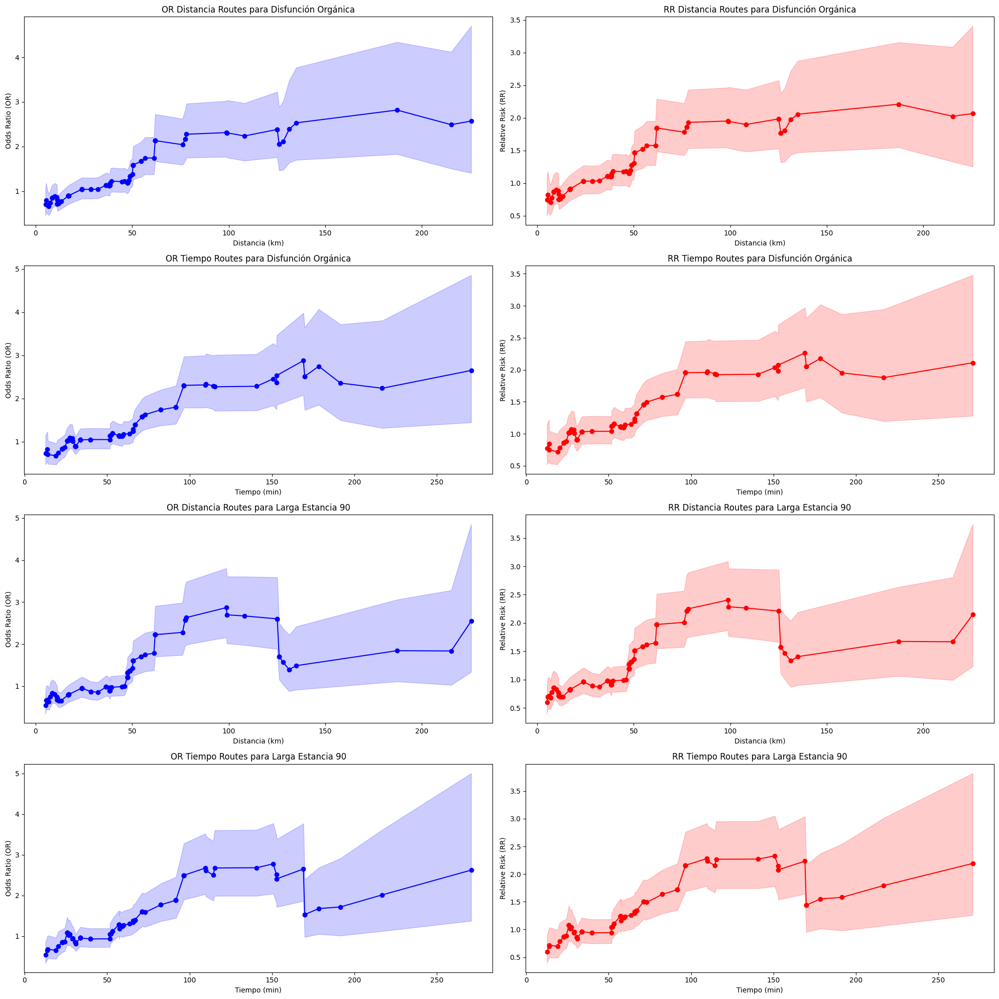

In [29]:
# Variables de interés
variables_interes = [
    'distancia_routes', 'tiempo_routes'
]
y_vars = ['multi_organ_disfuncion', 'larga_estancia_90']

# Normalizar las variables de interés
scaler = StandardScaler()
final_scaled = final.copy()
final_scaled[variables_interes] = scaler.fit_transform(final_scaled[variables_interes])

# Función para calcular OR y su intervalo de confianza
def calculate_odds_ratio_uni(result, variable):
    params = result.params
    conf = result.conf_int()
    or_value = np.exp(params[variable])
    conf_int = conf.loc[variable].apply(np.exp)
    return or_value, conf_int[0], conf_int[1]

# Función para ajustar un modelo logístico univariado y calcular el OR
def logistic_regression_uni(df, variable, outcome):
    df_uni = df[[variable, outcome]].dropna()
    X_uni = df_uni.drop(outcome, axis=1)
    y_uni = df_uni[outcome]
    X_uni = sm.add_constant(X_uni)
    model_uni = sm.Logit(y_uni, X_uni)
    result_uni = model_uni.fit(disp=0)
    or_value, ci_lower, ci_upper = calculate_odds_ratio_uni(result_uni, variable)
    return or_value, ci_lower, ci_upper

# Función para calcular RR y su intervalo de confianza usando Poisson
def calculate_risk_ratio_uni(result, variable):
    params = result.params
    conf = result.conf_int()
    rr_value = np.exp(params[variable])
    conf_int = conf.loc[variable].apply(np.exp)
    return rr_value, conf_int[0], conf_int[1]

# Función para ajustar un modelo de Poisson univariado y calcular el RR
def poisson_regression_uni(df, variable, outcome):
    df_uni = df[[variable, outcome]].dropna()
    X_uni = df_uni.drop(outcome, axis=1)
    y_uni = df_uni[outcome]
    X_uni = sm.add_constant(X_uni)
    model_uni = sm.GLM(y_uni, X_uni, family=sm.families.Poisson())
    result_uni = model_uni.fit(disp=0)
    rr_value, ci_lower, ci_upper = calculate_risk_ratio_uni(result_uni, variable)
    return rr_value, ci_lower, ci_upper

# Definir percentiles de interés del 5 al 99
percentiles = list(range(5, 99))

# Diccionarios para guardar los resultados
or_results_percentiles = {}
rr_results_percentiles = {}

# Función para calcular OR y RR por percentiles
def calculate_risks_by_percentiles(df, variable, outcome):
    results = {'OR': {}, 'RR': {}}
    for p in percentiles:
        threshold = np.percentile(df[variable], p)
        df['above_threshold'] = (df[variable] > threshold).astype(int)

        or_value, ci_lower_or, ci_upper_or = logistic_regression_uni(df, 'above_threshold', outcome)
        rr_value, ci_lower_rr, ci_upper_rr = poisson_regression_uni(df, 'above_threshold', outcome)

        results['OR'][p] = (or_value, ci_lower_or, ci_upper_or)
        results['RR'][p] = (rr_value, ci_lower_rr, ci_upper_rr)

    return results

# Calcular OR y RR por percentiles para cada variable de interés y cada outcome
for var in variables_interes:
    or_results_percentiles[var] = {}
    rr_results_percentiles[var] = {}
    for outcome in y_vars:
        results = calculate_risks_by_percentiles(final_scaled, var, outcome)
        or_results_percentiles[var][outcome] = results['OR']
        rr_results_percentiles[var][outcome] = results['RR']

# Desescalar los percentiles para obtener valores reales
percentile_values_scaled = final_scaled[variables_interes].quantile([p/100 for p in percentiles])
percentile_values_real = scaler.inverse_transform(percentile_values_scaled)
percentile_values_df = pd.DataFrame(percentile_values_real, index=percentiles, columns=variables_interes)
percentile_values_df.index.name = 'Percentil'

# Mostrar resultados
for var in variables_interes:
    for outcome in y_vars:
        print(f"\nResultados OR por percentiles para {var} y {outcome}:")
        or_results_df = pd.DataFrame(or_results_percentiles[var][outcome], index=['OR', 'CI Lower', 'CI Upper']).T
        print(or_results_df)

        print(f"\nResultados RR por percentiles para {var} y {outcome}:")
        rr_results_df = pd.DataFrame(rr_results_percentiles[var][outcome], index=['RR', 'CI Lower', 'CI Upper']).T
        print(rr_results_df)

# Graficar resultados
fig, axs = plt.subplots(4, 2, figsize=(20, 20))

# Función para graficar
def plot_results(ax, x, y, y_lower, y_upper, title, xlabel, ylabel, color):
    ax.plot(x, y, marker='o', color=color)
    ax.fill_between(x, y_lower, y_upper, color=color, alpha=0.2)
    ax.set_title(title)
    ax.set_xlabel(xlabel)
    ax.set_ylabel(ylabel)

# Subplots para multi_organ_disfuncion
distancia_real = percentile_values_df['distancia_routes'].values
tiempo_real = percentile_values_df['tiempo_routes'].values

plot_results(axs[0, 0], distancia_real, [or_results_percentiles['distancia_routes']['multi_organ_disfuncion'][p][0] for p in percentiles],
             [or_results_percentiles['distancia_routes']['multi_organ_disfuncion'][p][1] for p in percentiles],
             [or_results_percentiles['distancia_routes']['multi_organ_disfuncion'][p][2] for p in percentiles],
             'OR Distancia Routes para Disfunción Orgánica', 'Distancia (km)', 'Odds Ratio (OR)', 'blue')

plot_results(axs[0, 1], distancia_real, [rr_results_percentiles['distancia_routes']['multi_organ_disfuncion'][p][0] for p in percentiles],
             [rr_results_percentiles['distancia_routes']['multi_organ_disfuncion'][p][1] for p in percentiles],
             [rr_results_percentiles['distancia_routes']['multi_organ_disfuncion'][p][2] for p in percentiles],
             'RR Distancia Routes para Disfunción Orgánica', 'Distancia (km)', 'Relative Risk (RR)', 'red')

plot_results(axs[1, 0], tiempo_real, [or_results_percentiles['tiempo_routes']['multi_organ_disfuncion'][p][0] for p in percentiles],
             [or_results_percentiles['tiempo_routes']['multi_organ_disfuncion'][p][1] for p in percentiles],
             [or_results_percentiles['tiempo_routes']['multi_organ_disfuncion'][p][2] for p in percentiles],
             'OR Tiempo Routes para Disfunción Orgánica', 'Tiempo (min)', 'Odds Ratio (OR)', 'blue')

plot_results(axs[1, 1], tiempo_real, [rr_results_percentiles['tiempo_routes']['multi_organ_disfuncion'][p][0] for p in percentiles],
             [rr_results_percentiles['tiempo_routes']['multi_organ_disfuncion'][p][1] for p in percentiles],
             [rr_results_percentiles['tiempo_routes']['multi_organ_disfuncion'][p][2] for p in percentiles],
             'RR Tiempo Routes para Disfunción Orgánica', 'Tiempo (min)', 'Relative Risk (RR)', 'red')

# Subplots para larga_estancia_90
plot_results(axs[2, 0], distancia_real, [or_results_percentiles['distancia_routes']['larga_estancia_90'][p][0] for p in percentiles],
             [or_results_percentiles['distancia_routes']['larga_estancia_90'][p][1] for p in percentiles],
             [or_results_percentiles['distancia_routes']['larga_estancia_90'][p][2] for p in percentiles],
             'OR Distancia Routes para Larga Estancia 90', 'Distancia (km)', 'Odds Ratio (OR)', 'blue')

plot_results(axs[2, 1], distancia_real, [rr_results_percentiles['distancia_routes']['larga_estancia_90'][p][0] for p in percentiles],
             [rr_results_percentiles['distancia_routes']['larga_estancia_90'][p][1] for p in percentiles],
             [rr_results_percentiles['distancia_routes']['larga_estancia_90'][p][2] for p in percentiles],
             'RR Distancia Routes para Larga Estancia 90', 'Distancia (km)', 'Relative Risk (RR)', 'red')

plot_results(axs[3, 0], tiempo_real, [or_results_percentiles['tiempo_routes']['larga_estancia_90'][p][0] for p in percentiles],
             [or_results_percentiles['tiempo_routes']['larga_estancia_90'][p][1] for p in percentiles],
             [or_results_percentiles['tiempo_routes']['larga_estancia_90'][p][2] for p in percentiles],
             'OR Tiempo Routes para Larga Estancia 90', 'Tiempo (min)', 'Odds Ratio (OR)', 'blue')

plot_results(axs[3, 1], tiempo_real, [rr_results_percentiles['tiempo_routes']['larga_estancia_90'][p][0] for p in percentiles],
             [rr_results_percentiles['tiempo_routes']['larga_estancia_90'][p][1] for p in percentiles],
             [rr_results_percentiles['tiempo_routes']['larga_estancia_90'][p][2] for p in percentiles],
             'RR Tiempo Routes para Larga Estancia 90', 'Tiempo (min)', 'Relative Risk (RR)', 'red')

plt.tight_layout()
plt.show()


Adición de identificador de significancia (Línea discontinua sobre la unidad)


Resultados OR por percentiles para distancia_routes y multi_organ_disfuncion:
          OR  CI Lower  CI Upper
5   0.701910  0.452792  1.088090
6   0.790521  0.529328  1.180598
7   0.680830  0.469690  0.986884
8   0.655646  0.459022  0.936494
9   0.732284  0.518016  1.035179
10  0.842835  0.626266  1.134294
11  0.842835  0.626266  1.134294
12  0.842835  0.626266  1.134294
13  0.842835  0.626266  1.134294
14  0.842835  0.626266  1.134294
15  0.878182  0.656632  1.174484
16  0.863527  0.648795  1.149327
17  0.798890  0.606693  1.051972
18  0.709978  0.554547  0.908975
19  0.709978  0.554547  0.908975
20  0.709978  0.554547  0.908975
21  0.709978  0.554547  0.908975
22  0.709978  0.554547  0.908975
23  0.722303  0.565955  0.921842
24  0.765357  0.600102  0.976120
25  0.890509  0.705136  1.124614
26  0.890509  0.705136  1.124614
27  0.890509  0.705136  1.124614
28  0.890509  0.705136  1.124614
29  0.890509  0.705136  1.124614
30  0.897892  0.712420  1.131649
31  0.897892  0.712420  1.1316

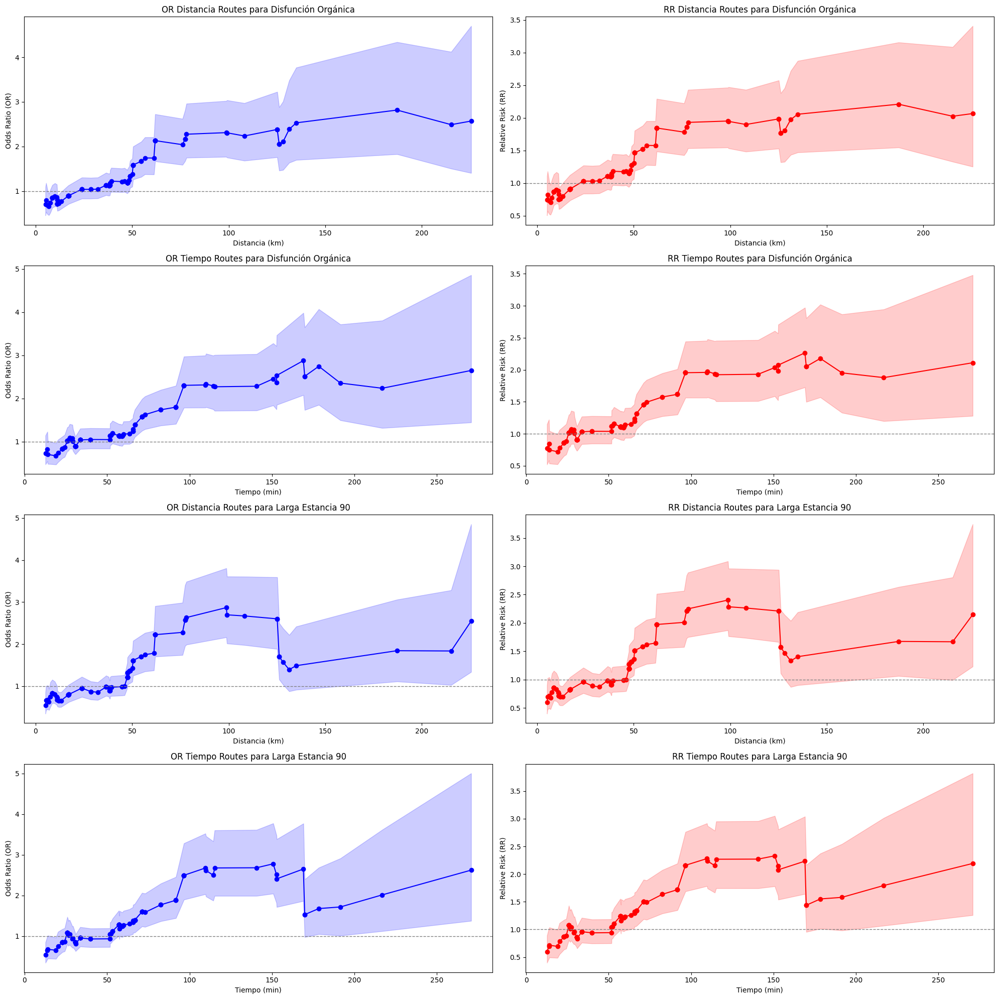

In [30]:
# Variables de interés
variables_interes = [
    'distancia_routes', 'tiempo_routes'
]
y_vars = ['multi_organ_disfuncion', 'larga_estancia_90']

# Normalizar las variables de interés
scaler = StandardScaler()
final_scaled = final.copy()
final_scaled[variables_interes] = scaler.fit_transform(final_scaled[variables_interes])

# Función para calcular OR y su intervalo de confianza
def calculate_odds_ratio_uni(result, variable):
    params = result.params
    conf = result.conf_int()
    or_value = np.exp(params[variable])
    conf_int = conf.loc[variable].apply(np.exp)
    return or_value, conf_int[0], conf_int[1]

# Función para ajustar un modelo logístico univariado y calcular el OR
def logistic_regression_uni(df, variable, outcome):
    df_uni = df[[variable, outcome]].dropna()
    X_uni = df_uni.drop(outcome, axis=1)
    y_uni = df_uni[outcome]
    X_uni = sm.add_constant(X_uni)
    model_uni = sm.Logit(y_uni, X_uni)
    result_uni = model_uni.fit(disp=0)
    or_value, ci_lower, ci_upper = calculate_odds_ratio_uni(result_uni, variable)
    return or_value, ci_lower, ci_upper

# Función para calcular RR y su intervalo de confianza usando Poisson
def calculate_risk_ratio_uni(result, variable):
    params = result.params
    conf = result.conf_int()
    rr_value = np.exp(params[variable])
    conf_int = conf.loc[variable].apply(np.exp)
    return rr_value, conf_int[0], conf_int[1]

# Función para ajustar un modelo de Poisson univariado y calcular el RR
def poisson_regression_uni(df, variable, outcome):
    df_uni = df[[variable, outcome]].dropna()
    X_uni = df_uni.drop(outcome, axis=1)
    y_uni = df_uni[outcome]
    X_uni = sm.add_constant(X_uni)
    model_uni = sm.GLM(y_uni, X_uni, family=sm.families.Poisson())
    result_uni = model_uni.fit(disp=0)
    rr_value, ci_lower, ci_upper = calculate_risk_ratio_uni(result_uni, variable)
    return rr_value, ci_lower, ci_upper

# Definir percentiles de interés del 5 al 99
percentiles = list(range(5, 99))

# Diccionarios para guardar los resultados
or_results_percentiles = {}
rr_results_percentiles = {}

# Función para calcular OR y RR por percentiles
def calculate_risks_by_percentiles(df, variable, outcome):
    results = {'OR': {}, 'RR': {}}
    for p in percentiles:
        threshold = np.percentile(df[variable], p)
        df['above_threshold'] = (df[variable] > threshold).astype(int)

        or_value, ci_lower_or, ci_upper_or = logistic_regression_uni(df, 'above_threshold', outcome)
        rr_value, ci_lower_rr, ci_upper_rr = poisson_regression_uni(df, 'above_threshold', outcome)

        results['OR'][p] = (or_value, ci_lower_or, ci_upper_or)
        results['RR'][p] = (rr_value, ci_lower_rr, ci_upper_rr)

    return results

# Calcular OR y RR por percentiles para cada variable de interés y cada outcome
for var in variables_interes:
    or_results_percentiles[var] = {}
    rr_results_percentiles[var] = {}
    for outcome in y_vars:
        results = calculate_risks_by_percentiles(final_scaled, var, outcome)
        or_results_percentiles[var][outcome] = results['OR']
        rr_results_percentiles[var][outcome] = results['RR']

# Desescalar los percentiles para obtener valores reales
percentile_values_scaled = final_scaled[variables_interes].quantile([p/100 for p in percentiles])
percentile_values_real = scaler.inverse_transform(percentile_values_scaled)
percentile_values_df = pd.DataFrame(percentile_values_real, index=percentiles, columns=variables_interes)
percentile_values_df.index.name = 'Percentil'

# Mostrar resultados
for var in variables_interes:
    for outcome in y_vars:
        print(f"\nResultados OR por percentiles para {var} y {outcome}:")
        or_results_df = pd.DataFrame(or_results_percentiles[var][outcome], index=['OR', 'CI Lower', 'CI Upper']).T
        print(or_results_df)

        print(f"\nResultados RR por percentiles para {var} y {outcome}:")
        rr_results_df = pd.DataFrame(rr_results_percentiles[var][outcome], index=['RR', 'CI Lower', 'CI Upper']).T
        print(rr_results_df)

# Graficar resultados
fig, axs = plt.subplots(4, 2, figsize=(20, 20))

# Función para graficar
def plot_results(ax, x, y, y_lower, y_upper, title, xlabel, ylabel, color):
    ax.plot(x, y, marker='o', color=color)
    ax.fill_between(x, y_lower, y_upper, color=color, alpha=0.2)
    ax.axhline(y=1, color='gray', linestyle='--', linewidth=1)  # Añadir línea discontinua en y=1
    ax.set_title(title)
    ax.set_xlabel(xlabel)
    ax.set_ylabel(ylabel)

# Subplots para multi_organ_disfuncion
distancia_real = percentile_values_df['distancia_routes'].values
tiempo_real = percentile_values_df['tiempo_routes'].values

plot_results(axs[0, 0], distancia_real, [or_results_percentiles['distancia_routes']['multi_organ_disfuncion'][p][0] for p in percentiles],
             [or_results_percentiles['distancia_routes']['multi_organ_disfuncion'][p][1] for p in percentiles],
             [or_results_percentiles['distancia_routes']['multi_organ_disfuncion'][p][2] for p in percentiles],
             'OR Distancia Routes para Disfunción Orgánica', 'Distancia (km)', 'Odds Ratio (OR)', 'blue')

plot_results(axs[0, 1], distancia_real, [rr_results_percentiles['distancia_routes']['multi_organ_disfuncion'][p][0] for p in percentiles],
             [rr_results_percentiles['distancia_routes']['multi_organ_disfuncion'][p][1] for p in percentiles],
             [rr_results_percentiles['distancia_routes']['multi_organ_disfuncion'][p][2] for p in percentiles],
             'RR Distancia Routes para Disfunción Orgánica', 'Distancia (km)', 'Relative Risk (RR)', 'red')

plot_results(axs[1, 0], tiempo_real, [or_results_percentiles['tiempo_routes']['multi_organ_disfuncion'][p][0] for p in percentiles],
             [or_results_percentiles['tiempo_routes']['multi_organ_disfuncion'][p][1] for p in percentiles],
             [or_results_percentiles['tiempo_routes']['multi_organ_disfuncion'][p][2] for p in percentiles],
             'OR Tiempo Routes para Disfunción Orgánica', 'Tiempo (min)', 'Odds Ratio (OR)', 'blue')

plot_results(axs[1, 1], tiempo_real, [rr_results_percentiles['tiempo_routes']['multi_organ_disfuncion'][p][0] for p in percentiles],
             [rr_results_percentiles['tiempo_routes']['multi_organ_disfuncion'][p][1] for p in percentiles],
             [rr_results_percentiles['tiempo_routes']['multi_organ_disfuncion'][p][2] for p in percentiles],
             'RR Tiempo Routes para Disfunción Orgánica', 'Tiempo (min)', 'Relative Risk (RR)', 'red')

# Subplots para larga_estancia_90
plot_results(axs[2, 0], distancia_real, [or_results_percentiles['distancia_routes']['larga_estancia_90'][p][0] for p in percentiles],
             [or_results_percentiles['distancia_routes']['larga_estancia_90'][p][1] for p in percentiles],
             [or_results_percentiles['distancia_routes']['larga_estancia_90'][p][2] for p in percentiles],
             'OR Distancia Routes para Larga Estancia 90', 'Distancia (km)', 'Odds Ratio (OR)', 'blue')

plot_results(axs[2, 1], distancia_real, [rr_results_percentiles['distancia_routes']['larga_estancia_90'][p][0] for p in percentiles],
             [rr_results_percentiles['distancia_routes']['larga_estancia_90'][p][1] for p in percentiles],
             [rr_results_percentiles['distancia_routes']['larga_estancia_90'][p][2] for p in percentiles],
             'RR Distancia Routes para Larga Estancia 90', 'Distancia (km)', 'Relative Risk (RR)', 'red')

plot_results(axs[3, 0], tiempo_real, [or_results_percentiles['tiempo_routes']['larga_estancia_90'][p][0] for p in percentiles],
             [or_results_percentiles['tiempo_routes']['larga_estancia_90'][p][1] for p in percentiles],
             [or_results_percentiles['tiempo_routes']['larga_estancia_90'][p][2] for p in percentiles],
             'OR Tiempo Routes para Larga Estancia 90', 'Tiempo (min)', 'Odds Ratio (OR)', 'blue')

plot_results(axs[3, 1], tiempo_real, [rr_results_percentiles['tiempo_routes']['larga_estancia_90'][p][0] for p in percentiles],
             [rr_results_percentiles['tiempo_routes']['larga_estancia_90'][p][1] for p in percentiles],
             [rr_results_percentiles['tiempo_routes']['larga_estancia_90'][p][2] for p in percentiles],
             'RR Tiempo Routes para Larga Estancia 90', 'Tiempo (min)', 'Relative Risk (RR)', 'red')

plt.tight_layout()
plt.show()



Resultados OR por percentiles para distancia_routes y multi_organ_disfuncion:
          OR  CI Lower  CI Upper
5   0.701910  0.452792  1.088090
6   0.790521  0.529328  1.180598
7   0.680830  0.469690  0.986884
8   0.655646  0.459022  0.936494
9   0.732284  0.518016  1.035179
10  0.842835  0.626266  1.134294
11  0.842835  0.626266  1.134294
12  0.842835  0.626266  1.134294
13  0.842835  0.626266  1.134294
14  0.842835  0.626266  1.134294
15  0.878182  0.656632  1.174484
16  0.863527  0.648795  1.149327
17  0.798890  0.606693  1.051972
18  0.709978  0.554547  0.908975
19  0.709978  0.554547  0.908975
20  0.709978  0.554547  0.908975
21  0.709978  0.554547  0.908975
22  0.709978  0.554547  0.908975
23  0.722303  0.565955  0.921842
24  0.765357  0.600102  0.976120
25  0.890509  0.705136  1.124614
26  0.890509  0.705136  1.124614
27  0.890509  0.705136  1.124614
28  0.890509  0.705136  1.124614
29  0.890509  0.705136  1.124614
30  0.897892  0.712420  1.131649
31  0.897892  0.712420  1.1316

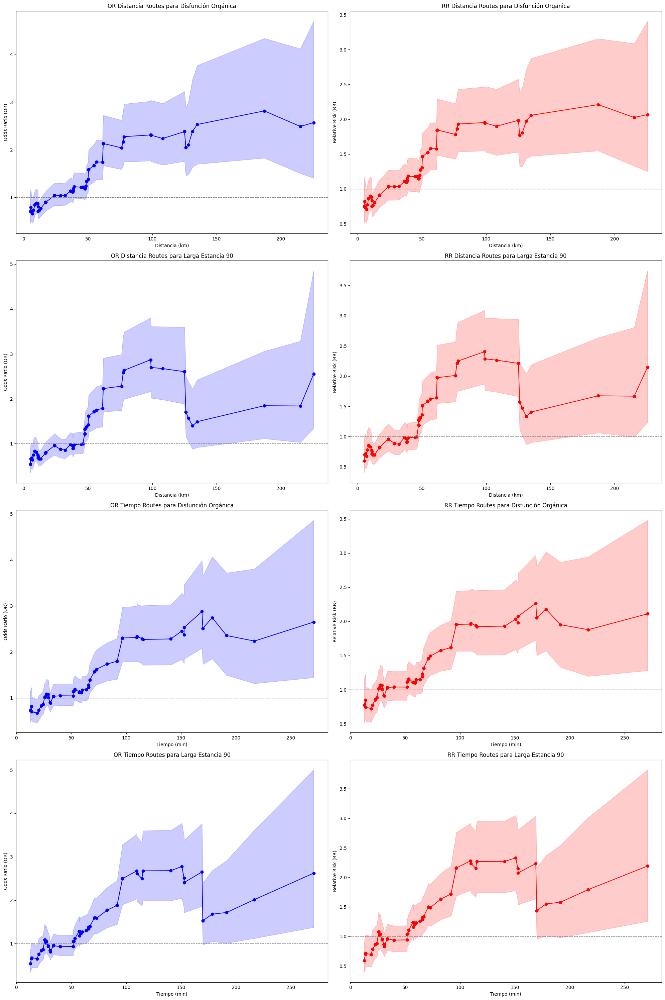

In [31]:
pd.set_option('display.max_rows', None)

# Variables de interés
variables_interes = [
    'distancia_routes', 'tiempo_routes'
]
y_vars = ['multi_organ_disfuncion', 'larga_estancia_90']

# Normalizar las variables de interés
scaler = StandardScaler()
final_scaled = final.copy()
final_scaled[variables_interes] = scaler.fit_transform(final_scaled[variables_interes])

# Función para calcular OR y su intervalo de confianza
def calculate_odds_ratio_uni(result, variable):
    params = result.params
    conf = result.conf_int()
    or_value = np.exp(params[variable])
    conf_int = conf.loc[variable].apply(np.exp)
    return or_value, conf_int[0], conf_int[1]

# Función para ajustar un modelo logístico univariado y calcular el OR
def logistic_regression_uni(df, variable, outcome):
    df_uni = df[[variable, outcome]].dropna()
    X_uni = df_uni.drop(outcome, axis=1)
    y_uni = df_uni[outcome]
    X_uni = sm.add_constant(X_uni)
    model_uni = sm.Logit(y_uni, X_uni)
    result_uni = model_uni.fit(disp=0)
    or_value, ci_lower, ci_upper = calculate_odds_ratio_uni(result_uni, variable)
    return or_value, ci_lower, ci_upper

# Función para calcular RR y su intervalo de confianza usando Poisson
def calculate_risk_ratio_uni(result, variable):
    params = result.params
    conf = result.conf_int()
    rr_value = np.exp(params[variable])
    conf_int = conf.loc[variable].apply(np.exp)
    return rr_value, conf_int[0], conf_int[1]

# Función para ajustar un modelo de Poisson univariado y calcular el RR
def poisson_regression_uni(df, variable, outcome):
    df_uni = df[[variable, outcome]].dropna()
    X_uni = df_uni.drop(outcome, axis=1)
    y_uni = df_uni[outcome]
    X_uni = sm.add_constant(X_uni)
    model_uni = sm.GLM(y_uni, X_uni, family=sm.families.Poisson())
    result_uni = model_uni.fit(disp=0)
    rr_value, ci_lower, ci_upper = calculate_risk_ratio_uni(result_uni, variable)
    return rr_value, ci_lower, ci_upper

# Definir percentiles de interés del 1 al 100, incluyendo los especificados
percentiles = list(range(5, 99))

# Diccionarios para guardar los resultados
or_results_percentiles = {}
rr_results_percentiles = {}

# Función para calcular OR y RR por percentiles
def calculate_risks_by_percentiles(df, variable, outcome):
    results = {'OR': {}, 'RR': {}}
    for p in percentiles:
        threshold = np.percentile(df[variable], p)
        df['above_threshold'] = (df[variable] > threshold).astype(int)

        or_value, ci_lower_or, ci_upper_or = logistic_regression_uni(df, 'above_threshold', outcome)
        rr_value, ci_lower_rr, ci_upper_rr = poisson_regression_uni(df, 'above_threshold', outcome)

        results['OR'][p] = (or_value, ci_lower_or, ci_upper_or)
        results['RR'][p] = (rr_value, ci_lower_rr, ci_upper_rr)

    return results

# Calcular OR y RR por percentiles para cada variable de interés y cada outcome
for var in variables_interes:
    or_results_percentiles[var] = {}
    rr_results_percentiles[var] = {}
    for outcome in y_vars:
        results = calculate_risks_by_percentiles(final_scaled, var, outcome)
        or_results_percentiles[var][outcome] = results['OR']
        rr_results_percentiles[var][outcome] = results['RR']

# Desescalar los percentiles para obtener valores reales
percentile_values_scaled = final_scaled[variables_interes].quantile([p/100 for p in percentiles])
percentile_values_real = scaler.inverse_transform(percentile_values_scaled)
percentile_values_df = pd.DataFrame(percentile_values_real, index=percentiles, columns=variables_interes)
percentile_values_df.index.name = 'Percentil'

# Mostrar resultados
for var in variables_interes:
    for outcome in y_vars:
        print(f"\nResultados OR por percentiles para {var} y {outcome}:")
        or_results_df = pd.DataFrame(or_results_percentiles[var][outcome], index=['OR', 'CI Lower', 'CI Upper']).T
        print(or_results_df)

        print(f"\nResultados RR por percentiles para {var} y {outcome}:")
        rr_results_df = pd.DataFrame(rr_results_percentiles[var][outcome], index=['RR', 'CI Lower', 'CI Upper']).T
        print(rr_results_df)

# Resultados en grupos
fig, axs = plt.subplots(4, 2, figsize=(20, 30))

# Función para graficar
def plot_results(ax, x, y, y_lower, y_upper, title, xlabel, ylabel, color):
    ax.plot(x, y, marker='o', color=color)
    ax.fill_between(x, y_lower, y_upper, color=color, alpha=0.2)
    ax.axhline(y=1, color='gray', linestyle='--', linewidth=1)  # Añadir línea discontinua en y=1
    ax.set_title(title)
    ax.set_xlabel(xlabel)
    ax.set_ylabel(ylabel)

# Subplots para multi_organ_disfuncion
distancia_real = percentile_values_df['distancia_routes'].values
tiempo_real = percentile_values_df['tiempo_routes'].values

plot_results(axs[0, 0], distancia_real, [or_results_percentiles['distancia_routes']['multi_organ_disfuncion'][p][0] for p in percentiles],
             [or_results_percentiles['distancia_routes']['multi_organ_disfuncion'][p][1] for p in percentiles],
             [or_results_percentiles['distancia_routes']['multi_organ_disfuncion'][p][2] for p in percentiles],
             'OR Distancia Routes para Disfunción Orgánica', 'Distancia (km)', 'Odds Ratio (OR)', 'blue')

plot_results(axs[0, 1], distancia_real, [rr_results_percentiles['distancia_routes']['multi_organ_disfuncion'][p][0] for p in percentiles],
             [rr_results_percentiles['distancia_routes']['multi_organ_disfuncion'][p][1] for p in percentiles],
             [rr_results_percentiles['distancia_routes']['multi_organ_disfuncion'][p][2] for p in percentiles],
             'RR Distancia Routes para Disfunción Orgánica', 'Distancia (km)', 'Relative Risk (RR)', 'red')

# Subplots para larga_estancia_90
plot_results(axs[1, 0], distancia_real, [or_results_percentiles['distancia_routes']['larga_estancia_90'][p][0] for p in percentiles],
             [or_results_percentiles['distancia_routes']['larga_estancia_90'][p][1] for p in percentiles],
             [or_results_percentiles['distancia_routes']['larga_estancia_90'][p][2] for p in percentiles],
             'OR Distancia Routes para Larga Estancia 90', 'Distancia (km)', 'Odds Ratio (OR)', 'blue')

plot_results(axs[1, 1], distancia_real, [rr_results_percentiles['distancia_routes']['larga_estancia_90'][p][0] for p in percentiles],
             [rr_results_percentiles['distancia_routes']['larga_estancia_90'][p][1] for p in percentiles],
             [rr_results_percentiles['distancia_routes']['larga_estancia_90'][p][2] for p in percentiles],
             'RR Distancia Routes para Larga Estancia 90', 'Distancia (km)', 'Relative Risk (RR)', 'red')

# Subplots para tiempo_routes
plot_results(axs[2, 0], tiempo_real, [or_results_percentiles['tiempo_routes']['multi_organ_disfuncion'][p][0] for p in percentiles],
             [or_results_percentiles['tiempo_routes']['multi_organ_disfuncion'][p][1] for p in percentiles],
             [or_results_percentiles['tiempo_routes']['multi_organ_disfuncion'][p][2] for p in percentiles],
             'OR Tiempo Routes para Disfunción Orgánica', 'Tiempo (min)', 'Odds Ratio (OR)', 'blue')

plot_results(axs[2, 1], tiempo_real, [rr_results_percentiles['tiempo_routes']['multi_organ_disfuncion'][p][0] for p in percentiles],
             [rr_results_percentiles['tiempo_routes']['multi_organ_disfuncion'][p][1] for p in percentiles],
             [rr_results_percentiles['tiempo_routes']['multi_organ_disfuncion'][p][2] for p in percentiles],
             'RR Tiempo Routes para Disfunción Orgánica', 'Tiempo (min)', 'Relative Risk (RR)', 'red')

# Subplots para larga_estancia_90
plot_results(axs[3, 0], tiempo_real, [or_results_percentiles['tiempo_routes']['larga_estancia_90'][p][0] for p in percentiles],
             [or_results_percentiles['tiempo_routes']['larga_estancia_90'][p][1] for p in percentiles],
             [or_results_percentiles['tiempo_routes']['larga_estancia_90'][p][2] for p in percentiles],
             'OR Tiempo Routes para Larga Estancia 90', 'Tiempo (min)', 'Odds Ratio (OR)', 'blue')

plot_results(axs[3, 1], tiempo_real, [rr_results_percentiles['tiempo_routes']['larga_estancia_90'][p][0] for p in percentiles],
             [rr_results_percentiles['tiempo_routes']['larga_estancia_90'][p][1] for p in percentiles],
             [rr_results_percentiles['tiempo_routes']['larga_estancia_90'][p][2] for p in percentiles],
             'RR Tiempo Routes para Larga Estancia 90', 'Tiempo (min)', 'Relative Risk (RR)', 'red')

plt.tight_layout()
plt.show()


# IDENTIFICACIÓN DE PUNTOS DE SIGNIFICANCIA PARA TIEMPO Y DISTANCIA DE TRASLADO

In [32]:
# Puntos de significancia
significant_points_or = {}
significant_points_rr = {}

for var in variables_interes:
    for outcome in y_vars:
        or_data = or_results_percentiles[var][outcome]
        rr_data = rr_results_percentiles[var][outcome]

        # Percentil donde ambos límites del CI del OR y RR > 1
        significant_or = next((p for p in percentiles if or_data[p][1] > 1 and or_data[p][2] > 1), None)
        significant_rr = next((p for p in percentiles if rr_data[p][1] > 1 and rr_data[p][2] > 1), None)

        if significant_or is not None:
            significant_points_or[f"{var}_{outcome}"] = (significant_or, percentile_values_df.loc[significant_or, var])
        if significant_rr is not None:
            significant_points_rr[f"{var}_{outcome}"] = (significant_rr, percentile_values_df.loc[significant_rr, var])

# Imprimir los puntos críticos
print("Puntos críticos OR:")
for key, value in significant_points_or.items():
    print(f"Variable/Desenlace: {key}, Percentil: {value[0]}, Valor: {value[1]}")

print("\nPuntos críticos RR:")
for key, value in significant_points_rr.items():
    print(f"Variable/Desenlace: {key}, Percentil: {value[0]}, Valor: {value[1]}")


Puntos críticos OR:
Variable/Desenlace: distancia_routes_multi_organ_disfuncion, Percentil: 66, Valor: 48.876
Variable/Desenlace: distancia_routes_larga_estancia_90, Percentil: 62, Valor: 47.573
Variable/Desenlace: tiempo_routes_multi_organ_disfuncion, Percentil: 66, Valor: 65.76666666666667
Variable/Desenlace: tiempo_routes_larga_estancia_90, Percentil: 45, Valor: 57.13333333333333

Puntos críticos RR:
Variable/Desenlace: distancia_routes_multi_organ_disfuncion, Percentil: 66, Valor: 48.876
Variable/Desenlace: distancia_routes_larga_estancia_90, Percentil: 62, Valor: 47.573
Variable/Desenlace: tiempo_routes_multi_organ_disfuncion, Percentil: 66, Valor: 65.76666666666667
Variable/Desenlace: tiempo_routes_larga_estancia_90, Percentil: 63, Valor: 63.56666666666667


# MAPAS

# Mapa dinámico de pacientes remitidas con ficha de Mrobilidad materna extrema, 2017 - 2023

In [33]:
# Cargar los datos
final = pd.read_excel('routes_dt.xlsx')

# Coordenadas de la Fundación Valle del Lili
lat_destino = 3.372201
lon_destino = -76.525715

# Crear mapa centrado en el destino
mapa_puntos = folium.Map(location=[lat_destino, lon_destino], zoom_start=7, tiles='OpenStreetMap')

# Añadir marcador de destino más grande en verde
folium.CircleMarker(
    [lat_destino, lon_destino],
    radius=10,
    color='green',
    fill=True,
    fill_color='green',
    popup='Fundación Valle del Lili',
    tooltip='Fundación Valle del Lili'
).add_to(mapa_puntos)

# Añadir marcadores de origen en rojo
for idx, row in final.iterrows():
    folium.CircleMarker(
        [row['Latitud_h'], row['Longitud_h']],
        radius=3,
        color='red',
        fill=True,
        fill_color='red',
        popup=f"{row['Inst_corregida']} ({row['año']})"
    ).add_to(mapa_puntos)

# Guardar y mostrar el mapa
mapa_puntos


# Mapa dinámico (Pop up con tiempo y distancia estimados de traslado hasta Fundación Valle del Lili)

In [34]:
# Cargar los datos
final = pd.read_excel('routes_dt.xlsx')

# Lista de municipios de difícil acceso
municipios_dificil_acceso = ['TIMBIQUÍ', 'LETICIA', 'GUAPI', 'BAJO BAUDÓ', 'LÓPEZ DE MICAY', 'MITÚ', 'CARTAGENA DEL CHAIRÁ']

# Coordenadas de la Fundación Valle del Lili
lat_destino = 3.372201
lon_destino = -76.525715

# Crear mapa centrado en el destino
mapa_puntos = folium.Map(location=[lat_destino, lon_destino], zoom_start=7, tiles='OpenStreetMap')

# Añadir marcador de destino más grande en verde
folium.CircleMarker(
    [lat_destino, lon_destino],
    radius=10,
    color='green',
    fill=True,
    fill_color='green',
    popup='Fundación Valle del Lili',
    tooltip='Fundación Valle del Lili'
).add_to(mapa_puntos)

# Añadir marcadores de origen en rojo
for idx, row in final.iterrows():
    if row['nmun_proce'] in municipios_dificil_acceso:
        # Mensaje especial para lugares de difícil acceso
        popup_content = f"{row['Inst_corregida']}<br>Transporte terrestre imposible<br>Distancia Haversine: {row['distancia_haversine_km']:.2f} km"
    else:
        # Mensaje normal para otros lugares
        distancia = "{:.2f}".format(row['distancia_routes'])
        tiempo = "{:.2f}".format(row['tiempo_routes'])
        popup_content = f"{row['Inst_corregida']} ({row['año']})<br>Distancia: {distancia} km<br>Tiempo estimado: {tiempo} min"

    folium.CircleMarker(
        [row['Latitud_h'], row['Longitud_h']],
        radius=3,
        color='red',
        fill=True,
        fill_color='red',
        popup=folium.Popup(popup_content, max_width=250)
    ).add_to(mapa_puntos)

# Guardar y mostrar el mapa
mapa_puntos.save('mapa_puntos.html')
mapa_puntos


Archivo de mapas en Drive

In [36]:
# Montar Google Drive
drive.mount('/content/drive')


Mounted at /content/drive


In [37]:
# Especificar la ruta en Google Drive
ruta_drive = '/content/drive/My Drive/mapa_puntos.html'

# Guardar el mapa en Google Drive
mapa_puntos.save(ruta_drive)
print(f"Mapa guardado en: {ruta_drive}")

Mapa guardado en: /content/drive/My Drive/mapa_puntos.html


# Mapa dinámico - Visualización de conexiones (Fundación Valle del Lili - Hospitales remitentes de pacientes con Morbilidad Materna Extrema)

In [38]:
# Crear otro mapa para incluir líneas
mapa_lineas = folium.Map(location=[lat_destino, lon_destino], zoom_start=7, tiles='OpenStreetMap')

# Punto de llegada
folium.CircleMarker(
    [lat_destino, lon_destino],
    radius=10,
    color='green',
    fill=True,
    fill_color='green',
    popup='Fundación Valle del Lili',
    tooltip='Fundación Valle del Lili'
).add_to(mapa_lineas)

# Puntos y líneas de origen
for idx, row in final.iterrows():
    folium.CircleMarker(
        [row['Latitud_h'], row['Longitud_h']],
        radius=5,
        color='red',
        fill=True,
        fill_color='red',
        popup=f"{row['Inst_corregida']} ({row['año']})"
    ).add_to(mapa_lineas)

    folium.PolyLine(
        locations=[[row['Latitud_h'], row['Longitud_h']], [lat_destino, lon_destino]],
        color='blue',
        weight=1.5,
        opacity=0.3,
        dash_array='1'
    ).add_to(mapa_lineas)

# Guardar y mostrar el mapa con líneas
mapa_lineas


# Mapa dinámico de Instituciones remitentes 2017 - 2023 y Pacientes por condición clínica

In [39]:
from folium.plugins import MarkerCluster

# Cargar el DataFrame
final = pd.read_excel('routes_dt.xlsx')

# Coordenadas del hospital receptor (Fundación Valle del Lili)
lat_destino = 3.372201
lon_destino = -76.525715

# Crear el mapa
mapa_condiciones = folium.Map(location=[lat_destino, lon_destino], zoom_start=8, tiles='OpenStreetMap')

# Punto de llegada
folium.CircleMarker(
    [lat_destino, lon_destino],
    radius=7,
    color='green',
    fill=True,
    fill_color='green',
    popup='Fundación Valle del Lili',
    tooltip='Fundación Valle del Lili'
).add_to(mapa_condiciones)

# Definir las condiciones y sus colores correspondientes
conditions = {
    'Trastornos hipertensivos': 'blue',
    'Complicaciones hemorrágicas': 'red',
    'Complicaciones de aborto': 'purple',
    'Sepsis de origen obstétrico': 'orange',
    'Sepsis de origen no obstétrico': 'yellow',
    'Sepsis de origen pulmonar': 'darkblue',
    'Enfermedad preexistente que se complica': 'pink',
    'Otra causa': 'gray'
}

# Contador de casos por condición
condition_count = {condition: 0 for condition in conditions.keys()}

# Agrupar marcadores para mantener el mapa organizado
marker_cluster = MarkerCluster().add_to(mapa_condiciones)

# Añadir los marcadores de origen con colores según la condición
for idx, row in final.iterrows():
    for condition, color in conditions.items():
        if row[condition]:
            condition_count[condition] += 1  # Incrementar contador de la condición
            folium.CircleMarker(
                [row['Latitud_h'], row['Longitud_h']],
                radius=5,
                color=color,
                fill=True,
                fill_color=color,
                popup=f"{row['Inst_corregida']} ({row['año']}) - {condition}"
            ).add_to(marker_cluster)
            break  # Solo usar el primer color correspondiente

# Crear el recuadro de leyenda para el mapa
legend_html = '''
<div style="position: fixed;
            bottom: 50px; right: 50px; width: 250px; height: 300px;
            border:2px solid grey; z-index:9999; font-size:14px;
            background-color:white; padding:10px; opacity: 0.9;">
    <h4>Condiciones Clínicas</h4>
    <ul style="list-style-type:none; margin:0; padding:0;">
        <li><span style="color:blue; font-size:16px;">●</span> Trastornos hipertensivos: <strong>{n_hypertensive}</strong></li>
        <li><span style="color:red; font-size:16px;">●</span> Complicaciones hemorrágicas: <strong>{n_hemorrhagic}</strong></li>
        <li><span style="color:purple; font-size:16px;">●</span> Complicaciones de aborto: <strong>{n_abortion}</strong></li>
        <li><span style="color:orange; font-size:16px;">●</span> Sepsis de origen obstétrico: <strong>{n_obstetric_sepsis}</strong></li>
        <li><span style="color:yellow; font-size:16px;">●</span> Sepsis de origen no obstétrico: <strong>{n_non_obstetric_sepsis}</strong></li>
        <li><span style="color:darkblue; font-size:16px;">●</span> Sepsis de origen pulmonar: <strong>{n_pulmonary_sepsis}</strong></li>
        <li><span style="color:pink; font-size:16px;">●</span> Enfermedad preexistente que se complica: <strong>{n_complicated_disease}</strong></li>
        <li><span style="color:gray; font-size:16px;">●</span> Otra causa: <strong>{n_other}</strong></li>
    </ul>
</div>
'''.format(
    n_hypertensive=final['Trastornos hipertensivos'].sum(),
    n_hemorrhagic=final['Complicaciones hemorrágicas'].sum(),
    n_abortion=final['Complicaciones de aborto'].sum(),
    n_obstetric_sepsis=final['Sepsis de origen obstétrico'].sum(),
    n_non_obstetric_sepsis=final['Sepsis de origen no obstétrico'].sum(),
    n_pulmonary_sepsis=final['Sepsis de origen pulmonar'].sum(),
    n_complicated_disease=final['Enfermedad preexistente que se complica'].sum(),
    n_other=final['Otra causa'].sum()
)

# Añadir la leyenda al mapa
mapa_condiciones.get_root().html.add_child(folium.Element(legend_html))

# Guardar el mapa
mapa_condiciones.save('mapa_condiciones_morbilidad.html')

# Mostrar conteo de casos por condición
for condition, count in condition_count.items():
    print(f"{condition}: {count} casos")

# Mostrar el mapa
mapa_condiciones


Trastornos hipertensivos: 1139 casos
Complicaciones hemorrágicas: 305 casos
Complicaciones de aborto: 43 casos
Sepsis de origen obstétrico: 677 casos
Sepsis de origen no obstétrico: 55 casos
Sepsis de origen pulmonar: 28 casos
Enfermedad preexistente que se complica: 98 casos
Otra causa: 108 casos


# Institución Remitente y condiciones clínicas 2019

2019

In [40]:

# Filtrar datos para 2019
final_2019 = final[final['año'] == 2019]

# Crear el mapa para 2019
mapa_2019 = folium.Map(location=[lat_destino, lon_destino], zoom_start=8, tiles='OpenStreetMap')

# Punto de llegada
folium.CircleMarker(
    [lat_destino, lon_destino],
    radius=7,
    color='green',
    fill=True,
    fill_color='green',
    popup='Fundación Valle del Lili',
    tooltip='Fundación Valle del Lili'
).add_to(mapa_2019)

# Agrupar marcadores para mantener el mapa organizado
marker_cluster_2019 = MarkerCluster().add_to(mapa_2019)

# Añadir los marcadores de origen con colores según la condición
for idx, row in final_2019.iterrows():
    for condition, color in conditions.items():
        if row[condition]:
            folium.CircleMarker(
                [row['Latitud_h'], row['Longitud_h']],
                radius=5,
                color=color,
                fill=True,
                fill_color=color,
                popup=f"{row['Inst_corregida']} ({row['año']}) - {condition}"
            ).add_to(marker_cluster_2019)
            break

# Crear el recuadro de leyenda para el mapa de 2019
legend_html_2019 = '''
<div style="position: fixed;
            bottom: 50px; right: 50px; width: 250px; height: 300px;
            border:2px solid grey; z-index:9999; font-size:14px;
            background-color:white; padding:10px; opacity: 0.9;">
    <h4>Condiciones Clínicas 2019</h4>
    <ul style="list-style-type:none; margin:0; padding:0;">
        <li><span style="color:blue; font-size:16px;">●</span> Trastornos hipertensivos: <strong>{n_hypertensive}</strong></li>
        <li><span style="color:red; font-size:16px;">●</span> Complicaciones hemorrágicas: <strong>{n_hemorrhagic}</strong></li>
        <li><span style="color:purple; font-size:16px;">●</span> Complicaciones de aborto: <strong>{n_abortion}</strong></li>
        <li><span style="color:orange; font-size:16px;">●</span> Sepsis de origen obstétrico: <strong>{n_obstetric_sepsis}</strong></li>
        <li><span style="color:yellow; font-size:16px;">●</span> Sepsis de origen no obstétrico: <strong>{n_non_obstetric_sepsis}</strong></li>
        <li><span style="color:darkblue; font-size:16px;">●</span> Sepsis de origen pulmonar: <strong>{n_pulmonary_sepsis}</strong></li>
        <li><span style="color:pink; font-size:16px;">●</span> Enfermedad preexistente que se complica: <strong>{n_complicated_disease}</strong></li>
        <li><span style="color:gray; font-size:16px;">●</span> Otra causa: <strong>{n_other}</strong></li>
    </ul>
</div>
'''.format(
    n_hypertensive=final_2019['Trastornos hipertensivos'].sum(),
    n_hemorrhagic=final_2019['Complicaciones hemorrágicas'].sum(),
    n_abortion=final_2019['Complicaciones de aborto'].sum(),
    n_obstetric_sepsis=final_2019['Sepsis de origen obstétrico'].sum(),
    n_non_obstetric_sepsis=final_2019['Sepsis de origen no obstétrico'].sum(),
    n_pulmonary_sepsis=final_2019['Sepsis de origen pulmonar'].sum(),
    n_complicated_disease=final_2019['Enfermedad preexistente que se complica'].sum(),
    n_other=final_2019['Otra causa'].sum()
)

# Añadir la leyenda al mapa de 2019
mapa_2019.get_root().html.add_child(folium.Element(legend_html_2019))

# Guardar el mapa de 2019
mapa_2019.save('mapa_condiciones_2019.html')
print("Mapa 2019 guardado como 'mapa_condiciones_2019.html'")


Mapa 2019 guardado como 'mapa_condiciones_2019.html'


In [41]:
mapa_2019

# Institución Remitente y condiciones clínicas 2020

2020

In [42]:
# Filtrar datos para 2020
final_2020 = final[final['año'] == 2020]

# Crear el mapa para 2020
mapa_2020 = folium.Map(location=[lat_destino, lon_destino], zoom_start=8, tiles='OpenStreetMap')

# Punto de llegada
folium.CircleMarker(
    [lat_destino, lon_destino],
    radius=7,
    color='green',
    fill=True,
    fill_color='green',
    popup='Fundación Valle del Lili',
    tooltip='Fundación Valle del Lili'
).add_to(mapa_2020)

# Agrupar marcadores para mantener el mapa organizado
marker_cluster_2020 = MarkerCluster().add_to(mapa_2020)

# Añadir los marcadores de origen con colores según la condición
for idx, row in final_2020.iterrows():
    for condition, color in conditions.items():
        if row[condition]:
            folium.CircleMarker(
                [row['Latitud_h'], row['Longitud_h']],
                radius=5,
                color=color,
                fill=True,
                fill_color=color,
                popup=f"{row['Inst_corregida']} ({row['año']}) - {condition}"
            ).add_to(marker_cluster_2020)
            break

# Crear el recuadro de leyenda para el mapa de 2020
legend_html_2020 = '''
<div style="position: fixed;
            bottom: 50px; right: 50px; width: 250px; height: 300px;
            border:2px solid grey; z-index:9999; font-size:14px;
            background-color:white; padding:10px; opacity: 0.9;">
    <h4>Condiciones Clínicas 2020</h4>
    <ul style="list-style-type:none; margin:0; padding:0;">
        <li><span style="color:blue; font-size:16px;">●</span> Trastornos hipertensivos: <strong>{n_hypertensive}</strong></li>
        <li><span style="color:red; font-size:16px;">●</span> Complicaciones hemorrágicas: <strong>{n_hemorrhagic}</strong></li>
        <li><span style="color:purple; font-size:16px;">●</span> Complicaciones de aborto: <strong>{n_abortion}</strong></li>
        <li><span style="color:orange; font-size:16px;">●</span> Sepsis de origen obstétrico: <strong>{n_obstetric_sepsis}</strong></li>
        <li><span style="color:yellow; font-size:16px;">●</span> Sepsis de origen no obstétrico: <strong>{n_non_obstetric_sepsis}</strong></li>
        <li><span style="color:darkblue; font-size:16px;">●</span> Sepsis de origen pulmonar: <strong>{n_pulmonary_sepsis}</strong></li>
        <li><span style="color:pink; font-size:16px;">●</span> Enfermedad preexistente que se complica: <strong>{n_complicated_disease}</strong></li>
        <li><span style="color:gray; font-size:16px;">●</span> Otra causa: <strong>{n_other}</strong></li>
    </ul>
</div>
'''.format(
    n_hypertensive=final_2020['Trastornos hipertensivos'].sum(),
    n_hemorrhagic=final_2020['Complicaciones hemorrágicas'].sum(),
    n_abortion=final_2020['Complicaciones de aborto'].sum(),
    n_obstetric_sepsis=final_2020['Sepsis de origen obstétrico'].sum(),
    n_non_obstetric_sepsis=final_2020['Sepsis de origen no obstétrico'].sum(),
    n_pulmonary_sepsis=final_2020['Sepsis de origen pulmonar'].sum(),
    n_complicated_disease=final_2020['Enfermedad preexistente que se complica'].sum(),
    n_other=final_2020['Otra causa'].sum()
)

# Añadir la leyenda al mapa de 2020
mapa_2020.get_root().html.add_child(folium.Element(legend_html_2020))

# Guardar el mapa de 2020
mapa_2020.save('mapa_condiciones_2020.html')
print("Mapa 2020 guardado como 'mapa_condiciones_2020.html'")


Mapa 2020 guardado como 'mapa_condiciones_2020.html'


In [43]:
mapa_2020

# Institución Remitente y condiciones clínicas 2021

2021

In [44]:
# Filtrar datos para 2021
final_2021 = final[final['año'] == 2021]

# Crear el mapa para 2021
mapa_2021 = folium.Map(location=[lat_destino, lon_destino], zoom_start=8, tiles='OpenStreetMap')

# Punto de llegada
folium.CircleMarker(
    [lat_destino, lon_destino],
    radius=7,
    color='green',
    fill=True,
    fill_color='green',
    popup='Fundación Valle del Lili',
    tooltip='Fundación Valle del Lili'
).add_to(mapa_2021)

# Agrupar marcadores para mantener el mapa organizado
marker_cluster_2021 = MarkerCluster().add_to(mapa_2021)

# Añadir los marcadores de origen con colores según la condición
for idx, row in final_2021.iterrows():
    for condition, color in conditions.items():
        if row[condition]:
            folium.CircleMarker(
                [row['Latitud_h'], row['Longitud_h']],
                radius=5,
                color=color,
                fill=True,
                fill_color=color,
                popup=f"{row['Inst_corregida']} ({row['año']}) - {condition}"
            ).add_to(marker_cluster_2021)
            break

# Crear el recuadro de leyenda para el mapa de 2021
legend_html_2021 = '''
<div style="position: fixed;
            bottom: 50px; right: 50px; width: 250px; height: 300px;
            border:2px solid grey; z-index:9999; font-size:14px;
            background-color:white; padding:10px; opacity: 0.9;">
    <h4>Condiciones Clínicas 2021</h4>
    <ul style="list-style-type:none; margin:0; padding:0;">
        <li><span style="color:blue; font-size:16px;">●</span> Trastornos hipertensivos: <strong>{n_hypertensive}</strong></li>
        <li><span style="color:red; font-size:16px;">●</span> Complicaciones hemorrágicas: <strong>{n_hemorrhagic}</strong></li>
        <li><span style="color:purple; font-size:16px;">●</span> Complicaciones de aborto: <strong>{n_abortion}</strong></li>
        <li><span style="color:orange; font-size:16px;">●</span> Sepsis de origen obstétrico: <strong>{n_obstetric_sepsis}</strong></li>
        <li><span style="color:yellow; font-size:16px;">●</span> Sepsis de origen no obstétrico: <strong>{n_non_obstetric_sepsis}</strong></li>
        <li><span style="color:darkblue; font-size:16px;">●</span> Sepsis de origen pulmonar: <strong>{n_pulmonary_sepsis}</strong></li>
        <li><span style="color:pink; font-size:16px;">●</span> Enfermedad preexistente que se complica: <strong>{n_complicated_disease}</strong></li>
        <li><span style="color:gray; font-size:16px;">●</span> Otra causa: <strong>{n_other}</strong></li>
    </ul>
</div>
'''.format(
    n_hypertensive=final_2021['Trastornos hipertensivos'].sum(),
    n_hemorrhagic=final_2021['Complicaciones hemorrágicas'].sum(),
    n_abortion=final_2021['Complicaciones de aborto'].sum(),
    n_obstetric_sepsis=final_2021['Sepsis de origen obstétrico'].sum(),
    n_non_obstetric_sepsis=final_2021['Sepsis de origen no obstétrico'].sum(),
    n_pulmonary_sepsis=final_2021['Sepsis de origen pulmonar'].sum(),
    n_complicated_disease=final_2021['Enfermedad preexistente que se complica'].sum(),
    n_other=final_2021['Otra causa'].sum()
)

# Añadir la leyenda al mapa de 2021
mapa_2021.get_root().html.add_child(folium.Element(legend_html_2021))

# Guardar el mapa de 2021
mapa_2021.save('mapa_condiciones_2021.html')
print("Mapa 2021 guardado como 'mapa_condiciones_2021.html'")


Mapa 2021 guardado como 'mapa_condiciones_2021.html'


In [45]:
mapa_2021

# Institución Remitente y condiciones clínicas 2022

2022

In [46]:
# Filtrar datos para 2022
final_2022 = final[final['año'] == 2022]

# Crear el mapa para 2022
mapa_2022 = folium.Map(location=[lat_destino, lon_destino], zoom_start=8, tiles='OpenStreetMap')

# Punto de llegada
folium.CircleMarker(
    [lat_destino, lon_destino],
    radius=7,
    color='green',
    fill=True,
    fill_color='green',
    popup='Fundación Valle del Lili',
    tooltip='Fundación Valle del Lili'
).add_to(mapa_2022)

# Agrupar marcadores para mantener el mapa organizado
marker_cluster_2022 = MarkerCluster().add_to(mapa_2022)

# Añadir los marcadores de origen con colores según la condición
for idx, row in final_2022.iterrows():
    for condition, color in conditions.items():
        if row[condition]:
            folium.CircleMarker(
                [row['Latitud_h'], row['Longitud_h']],
                radius=5,
                color=color,
                fill=True,
                fill_color=color,
                popup=f"{row['Inst_corregida']} ({row['año']}) - {condition}"
            ).add_to(marker_cluster_2022)
            break

# Crear el recuadro de leyenda para el mapa de 2022
legend_html_2022 = '''
<div style="position: fixed;
            bottom: 50px; right: 50px; width: 250px; height: 300px;
            border:2px solid grey; z-index:9999; font-size:14px;
            background-color:white; padding:10px; opacity: 0.9;">
    <h4>Condiciones Clínicas 2022</h4>
    <ul style="list-style-type:none; margin:0; padding:0;">
        <li><span style="color:blue; font-size:16px;">●</span> Trastornos hipertensivos: <strong>{n_hypertensive}</strong></li>
        <li><span style="color:red; font-size:16px;">●</span> Complicaciones hemorrágicas: <strong>{n_hemorrhagic}</strong></li>
        <li><span style="color:purple; font-size:16px;">●</span> Complicaciones de aborto: <strong>{n_abortion}</strong></li>
        <li><span style="color:orange; font-size:16px;">●</span> Sepsis de origen obstétrico: <strong>{n_obstetric_sepsis}</strong></li>
        <li><span style="color:yellow; font-size:16px;">●</span> Sepsis de origen no obstétrico: <strong>{n_non_obstetric_sepsis}</strong></li>
        <li><span style="color:darkblue; font-size:16px;">●</span> Sepsis de origen pulmonar: <strong>{n_pulmonary_sepsis}</strong></li>
        <li><span style="color:pink; font-size:16px;">●</span> Enfermedad preexistente que se complica: <strong>{n_complicated_disease}</strong></li>
        <li><span style="color:gray; font-size:16px;">●</span> Otra causa: <strong>{n_other}</strong></li>
    </ul>
</div>
'''.format(
    n_hypertensive=final_2022['Trastornos hipertensivos'].sum(),
    n_hemorrhagic=final_2022['Complicaciones hemorrágicas'].sum(),
    n_abortion=final_2022['Complicaciones de aborto'].sum(),
    n_obstetric_sepsis=final_2022['Sepsis de origen obstétrico'].sum(),
    n_non_obstetric_sepsis=final_2022['Sepsis de origen no obstétrico'].sum(),
    n_pulmonary_sepsis=final_2022['Sepsis de origen pulmonar'].sum(),
    n_complicated_disease=final_2022['Enfermedad preexistente que se complica'].sum(),
    n_other=final_2022['Otra causa'].sum()
)

# Añadir la leyenda al mapa de 2022
mapa_2022.get_root().html.add_child(folium.Element(legend_html_2022))

# Guardar el mapa de 2022
mapa_2022.save('mapa_condiciones_2022.html')
print("Mapa 2022 guardado como 'mapa_condiciones_2022.html'")


Mapa 2022 guardado como 'mapa_condiciones_2022.html'


In [47]:
mapa_2022